<a href="https://colab.research.google.com/github/Leofierus/TA-Colabs/blob/main/Neuroinformatics/Allen_Data_Exploration.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Timer

In [ ]:
!curl -L "https://drive.google.com/uc?export=download&id=1rppXZgOI6M4xbJZJe2nMJcV_gxPGZM5h" > audio.mp3

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
  0     0    0     0    0     0      0      0 --:--:-- --:--:-- --:--:--     0
100 1445k  100 1445k    0     0   976k      0  0:00:01  0:00:01 --:--:-- 50.3M


In [ ]:
import time
from IPython.display import display, HTML, Audio

def countdown_timer(minutes, seconds):
    display(HTML(f"""
    <p id="timer" style="font-size:300px; color: red;"></p>
    <script>
    var minutes = {minutes};
    var seconds = {seconds};
    var timer = document.getElementById("timer");
    var alarm = document.getElementById("alarm");

    function updateTimer() {{
        if (seconds == 0 && minutes == 0) {{
            timer.innerHTML = "<span style='font-size: 300px; background-image: url(https://www.icegif.com/wp-content/uploads/2023/01/icegif-162.gif); background-clip: text; color: transparent; -webkit-background-clip: text;'>Let's start!</span>";
        }} else {{
            if (seconds == 0) {{
                minutes--;
                seconds = 59;
            }} else {{
                seconds--;
            }}
            var minutesDisplay = minutes.toString().padStart(2, '0');
            var secondsDisplay = seconds.toString().padStart(2, '0');
            timer.innerHTML = minutesDisplay + ":" + secondsDisplay;
            setTimeout(updateTimer, 1000);
        }}
    }}
    updateTimer();
    </script>
    """))
    time.sleep(minutes*60 + seconds - 3)
    sound_file = '/content/audio.mp3'
    display(Audio(sound_file, autoplay=True))

# Run the countdown timer for x minutes and x seconds
countdown_timer(5, 10)

# Imports

In [ ]:
!pip install --upgrade pip
!pip install allensdk

  Using cached numpy-1.23.5-cp311-cp311-manylinux_2_17_x86_64.manylinux2014_x86_64.whl.metadata (2.3 kB)
Using cached numpy-1.23.5-cp311-cp311-manylinux_2_17_x86_64.manylinux2014_x86_64.whl (17.1 MB)
  Attempting uninstall: numpy
    Found existing installation: numpy 1.26.4
    Uninstalling numpy-1.26.4:
      Successfully uninstalled numpy-1.26.4
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
zarr 2.18.4 requires numpy>=1.24, but you have numpy 1.23.5 which is incompatible.
numcodecs 0.15.1 requires numpy>=1.24, but you have numpy 1.23.5 which is incompatible.
hdmf-zarr 0.11.0 requires numpy>=1.24.0, but you have numpy 1.23.5 which is incompatible.
google-colab 1.0.0 requires pandas==2.2.2, but you have pandas 1.5.3 which is incompatible.
albumentations 2.0.4 requires numpy>=1.24.4, but you have numpy 1.23.5 which is incompatible.
tensorflow 2.18.0 requires 

In [ ]:
import os
import gc
import shutil
import xarray as xr
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

from pathlib import Path
from scipy.ndimage import gaussian_filter, gaussian_filter1d
from allensdk.brain_observatory.ecephys.ecephys_project_cache import EcephysProjectCache
from allensdk.brain_observatory.ecephys.stimulus_analysis.receptive_field_mapping import ReceptiveFieldMapping

# Data

### Tutorial overview

This Jupyter notebook covers the various methods for accessing the Allen Institute Neuropixels Visual Coding dataset. We will go over how to request data, where it's stored, and what the various files contain.  If you're having trouble downloading the data, or you just want to know more about what's going on under the hood, this is a good place to start.

Currently, Allen does not have a web interface for browsing through the available cells and experiments, as with the [two-photon imaging Visual Coding dataset](http://observatory.brain-map.org/visualcoding). Instead, the data must be retrieved through the AllenSDK (Python 3.6+), or via requests sent to [api.brain-map.org](http://mouse.brain-map.org/static/api).

### Options for data access

The **`EcephysProjectCache` object of the AllenSDK** is the easiest way to interact with the data. This object abstracts away the details of on-disk file storage, and delivers the data to you as ready-to-analyze Python objects. The cache will automatically keep track of which files are stored locally, and will download additional files on an as-needed basis. Usually you won't need to worry about how these files are structured, but this tutorial will cover those details in case you want to analyze them without using the AllenSDK.

If you have an **Amazon Web Services (AWS)** account, you can use an `EcephysProjectCache` object to access the data via the Allen Brain Observatory Simple Storage Service (S3) bucket. This is an AWS Public Dataset located at `arn:aws:s3:::allen-brain-observatory` in region `us-west-2`. Launching a Jupyter notebook instance on AWS will allow you to access the complete dataset without having to download anything locally. This includes around 80 TB of raw data files, which are not accessible via the AllenSDK. The only drawback is that you'll need to pay for the time that your instance is running—but this can still be economical in many cases.

A third option is to directly download the data via **api.brain-map.org**. This should be used only as a last resort if the other options are broken or are not available to you.

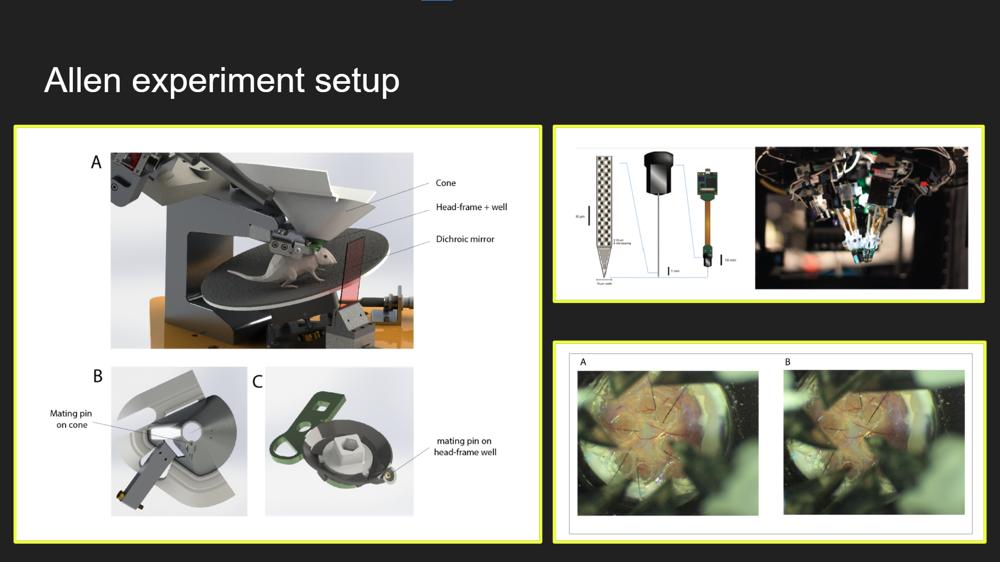

# Loading the data

It's better to access data via the AllenSDK. This requires nothing more than a Python interpreter and some free disk space to store the data locally.

How much data is there? If you want to download the complete dataset (58 experiments), you'll need 855 GB of space, split across the following files:

1. CSV files containing information about sessions, probes, channels and units (58.1 MB)
2. NWB files containing spike times, behavior data, and stimulus information for each session (146.5 GB total, min file size = 1.7 GB, max file size = 3.3 GB)
3. NWB files containing LFP data for each probe (707 GB total, min file size = 0.9 GB, max file size = 2.7 GB)

Before downloading the data, you must decide where the `manifest.json` file lives. This file serves as the map that guides the `EcephysProjectCache` object to the file locations.

When you initialize a local cache for the first time, it will create the manifest file at the path that you specify. This file lives in the same directory as the rest of the data, so make sure you put it somewhere that has enough space available.

When you need to access the data in subsequent analysis sessions, you should point the `EcephysProjectCache` object to an _existing_ `manifest.json` file; otherwise, it will try to re-download the data in a new location.

In [ ]:
output_dir = '/content/Allen_data/'
os.makedirs(output_dir, exist_ok=True)
DOWNLOAD_COMPLETE_DATASET = True

Next, we'll specify the location of the manifest file. If you're creating a cache for the first time, this file won't exist yet, but it **_must_** be placed in an existing data directory. Remember to choose a location that has plenty of free space available.

In [ ]:
manifest_path = os.path.join(output_dir, "manifest.json")
cache = EcephysProjectCache.from_warehouse(manifest=manifest_path)

This will prepare the cache to download four files:

1. `sessions.csv` (7.8 kB)
2. `probes.csv` (27.0 kB)
3. `channels.csv` (6.6 MB)
4. `units.csv` (51.4 MB)

Each one contains a table of information related to its file name. If you're using the AllenSDK, you won't have to worry about how these files are formatted. Instead, you'll load the relevant data using specific accessor functions: `get_session_table()`, `get_probes()`, `get_channels()`, and `get_units()`. These functions return a [pandas DataFrame](https://pandas.pydata.org/pandas-docs/stable/reference/frame.html?highlight=dataframe) containing a row for each item and a column for each metric.

If you are analyzing data without using the AllenSDK, you can load the data using your CSV file reader of choice. However, please be aware the columns in the original file do not necessarily match what's returned by the AllenSDK, which may combine information from multiple files to produce the final DataFrame.


Bug report: [Known bug where the cache files don't get downloaded](https://github.com/AllenInstitute/AllenSDK/issues/2753)

In [ ]:
%%time
!curl -L "https://drive.google.com/uc?export=download&id=1bBl5RUR5H88AT34253f4X6UKfTMKwti3" > /content/Allen_data/joined.csv
!curl -L "https://drive.google.com/uc?export=download&id=1UwKqdNliGt-vof1lwHSdBAhFlukBIoeC" > /content/Allen_data/probes.csv
!curl -L "https://drive.google.com/uc?export=download&id=1S-M8oX9K6AG9b2NVWTUcq6-FVV2I2bVQ" > /content/Allen_data/channels.csv
!curl -L "https://drive.google.com/uc?export=download&id=19nThrzWpdXV9W04Hs2ZLXJagksqDjPUV" > /content/Allen_data/sessions.csv
!curl -L "https://drive.google.com/uc?export=download&id=17ygB8V9VOFmcUv2fFkhfvkNhLSsFv5Ll" > /content/Allen_data/units.csv

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
  0     0    0     0    0     0      0      0 --:--:-- --:--:-- --:--:--     0
100 5394k  100 5394k    0     0  1305k      0  0:00:04  0:00:04 --:--:-- 1452k
  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
  0     0    0     0    0     0      0      0 --:--:-- --:--:-- --:--:--     0
100 27287  100 27287    0     0   7371      0  0:00:03  0:00:03 --:--:-- 12840
  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
  0     0    0     0    0     0      0      0 --:--:-- --:--:-- --:--:--     0
100 6315k  100 6315k    0     0  1459k      0  0:00:04  0:00:04 --:--:-- 1583k
  % Total    % Received % Xferd  Average Speed   Tim

The `sessions` DataFrame provides a high-level overview of the Neuropixels Visual Coding dataset. The index column is a unique ID, which serves as a key for accessing the physiology data for each session. The other columns contain information about:

- the session type (i.e., which stimulus set was shown?)
- the age, sex, and genotype of the mouse (in this dataset, there's only one session per mouse)
- the number of probes, channels, and units for each session
- the brain structures recorded (CCFv3 acronyms)

In [ ]:
while not os.path.exists(f'/content/Allen_data/sessions.csv'):
    print("Waiting for file to be downloaded...")
    time.sleep(60)
sessions = cache.get_session_table()
print('Total number of sessions: ' + str(len(sessions)))
sessions.head()

Total number of sessions: 58


,published_at,specimen_id,session_type,age_in_days,sex,full_genotype,unit_count,channel_count,probe_count,ecephys_structure_acronyms
id,,,,,,,,,,
715093703,2019-10-03T00:00:00Z,699733581,brain_observatory_1.1,118.0,M,Sst-IRES-Cre/wt;Ai32(RCL-ChR2(H134R)_EYFP)/wt,884,2219,6,"[CA1, VISrl, nan, PO, LP, LGd, CA3, DG, VISl, ..."
719161530,2019-10-03T00:00:00Z,703279284,brain_observatory_1.1,122.0,M,Sst-IRES-Cre/wt;Ai32(RCL-ChR2(H134R)_EYFP)/wt,755,2214,6,"[TH, Eth, APN, POL, LP, DG, CA1, VISpm, nan, N..."
721123822,2019-10-03T00:00:00Z,707296982,brain_observatory_1.1,125.0,M,Pvalb-IRES-Cre/wt;Ai32(RCL-ChR2(H134R)_EYFP)/wt,444,2229,6,"[MB, SCig, PPT, NOT, DG, CA1, VISam, nan, LP, ..."
732592105,2019-10-03T00:00:00Z,717038288,brain_observatory_1.1,100.0,M,wt/wt,824,1847,5,"[grey, VISpm, nan, VISp, VISl, VISal, VISrl]"
737581020,2019-10-03T00:00:00Z,718643567,brain_observatory_1.1,108.0,M,wt/wt,568,2218,6,"[grey, VISmma, nan, VISpm, VISp, VISl, VISrl]"


In [ ]:
sessions.index.unique()

Int64Index([715093703, 719161530, 721123822, 732592105, 737581020, 739448407,
            742951821, 743475441, 744228101, 746083955, 750332458, 750749662,
            751348571, 754312389, 754829445, 755434585, 756029989, 757216464,
            757970808, 758798717, 759883607, 760345702, 760693773, 761418226,
            762120172, 762602078, 763673393, 766640955, 767871931, 768515987,
            771160300, 771990200, 773418906, 774875821, 778240327, 778998620,
            779839471, 781842082, 786091066, 787025148, 789848216, 791319847,
            793224716, 794812542, 797828357, 798911424, 799864342, 816200189,
            819186360, 819701982, 821695405, 829720705, 831882777, 835479236,
            839068429, 839557629, 840012044, 847657808],
           dtype='int64', name='id')

If we want to find all of recordings from male Sst-Cre mice that viewed the Brain Observatory 1.1 stimulus and contain units from area LM, we can use the following query:

In [ ]:
filtered_sessions = sessions[(sessions.sex == 'M') & \
                             (sessions.full_genotype.str.find('Sst') > -1) & \
                             (sessions.session_type == 'brain_observatory_1.1') & \
                             (['VISl' in acronyms for acronyms in
                               sessions.ecephys_structure_acronyms])]

filtered_sessions.head()

,published_at,specimen_id,session_type,age_in_days,sex,full_genotype,unit_count,channel_count,probe_count,ecephys_structure_acronyms
id,,,,,,,,,,
715093703,2019-10-03T00:00:00Z,699733581,brain_observatory_1.1,118.0,M,Sst-IRES-Cre/wt;Ai32(RCL-ChR2(H134R)_EYFP)/wt,884,2219,6,"[CA1, VISrl, nan, PO, LP, LGd, CA3, DG, VISl, ..."
719161530,2019-10-03T00:00:00Z,703279284,brain_observatory_1.1,122.0,M,Sst-IRES-Cre/wt;Ai32(RCL-ChR2(H134R)_EYFP)/wt,755,2214,6,"[TH, Eth, APN, POL, LP, DG, CA1, VISpm, nan, N..."
756029989,2019-10-03T00:00:00Z,734865738,brain_observatory_1.1,96.0,M,Sst-IRES-Cre/wt;Ai32(RCL-ChR2(H134R)_EYFP)/wt,684,2214,6,"[TH, DG, CA3, CA1, VISl, nan, PO, Eth, LP, VIS..."


Let's take a look at another DataFrame, extracted from the `probes.csv` file.

In [ ]:
probes = cache.get_probes()
print('Total number of probes: ' + str(len(probes)))
probes.head()

Total number of probes: 332


,ecephys_session_id,lfp_sampling_rate,name,phase,sampling_rate,has_lfp_data,unit_count,channel_count,ecephys_structure_acronyms
id,,,,,,,,,
729445648,719161530,1249.998642,probeA,3a,29999.967418,True,87,374,"[APN, LP, MB, DG, CA1, VISam, nan]"
729445650,719161530,1249.996620,probeB,3a,29999.918880,True,202,368,"[TH, Eth, APN, POL, LP, DG, CA1, VISpm, nan]"
729445652,719161530,1249.999897,probeC,3a,29999.997521,True,207,373,"[APN, NOT, MB, DG, SUB, VISp, nan]"
729445654,719161530,1249.996707,probeD,3a,29999.920963,True,93,358,"[grey, VL, CA3, CA2, CA1, VISl, nan]"
729445656,719161530,1249.999979,probeE,3a,29999.999500,True,138,370,"[PO, VPM, TH, LP, LGd, CA3, DG, CA1, VISal, nan]"


The `probes` DataFrame contains information about the Neuropixels probes used across all recordings. Each row represents one probe from one recording session, even though the physical probes may have been used in multiple sessions. Some of the important columns are:

- `ecephys_session_id`: the index column of the `sessions` table
- `sampling_rate`: the sampling rate (in Hz) for this probe's spike band; note that each probe has a unique sampling rate around 30 kHz. The small variations in sampling rate across probes can add up to large offsets over time, so it's critical to take these differences into account. However, all of the data you will interact with has been pre-aligned to a common clock, so this value is included only for reference purposes.
- `lfp_sampling_rate`: the sampling rate (in Hz) for this probe's LFP band NWB files, after 2x downsampling from the original rate of 2.5 kHz
- `name`: the probe name is assigned based on the location of the probe on the recording rig. This is useful to keep in mind because probes with the same name are always targeted to the same cortical region and enter the brain from the same angle (`probeA` = AM, `probeB` = PM, `probeC` = V1, `probeD` = LM, `probeE` = AL, `probeF` = RL). However, the targeting is not always accurate, so the actual recorded region may be different.
- `phase`: the data may have been generated by one of two "phases" of Neuropixels probes. **3a** = prototype version; **PXI** = publicly available version ("Neuropixels 1.0"). The two phases should be equivalent from the perspective of data analysis, but there may be differences in the noise characteristics between the two acquisition systems.
- `channel_count`: the number of channels with spikes or LFP data (maximum = 384)

The `channels.csv` file contains information about each of these channels.

In [ ]:
channels = cache.get_channels()
print('Total number of channels: ' + str(len(channels)))
channels.head()

Total number of channels: 123224


,ecephys_probe_id,local_index,probe_horizontal_position,probe_vertical_position,anterior_posterior_ccf_coordinate,dorsal_ventral_ccf_coordinate,left_right_ccf_coordinate,ecephys_structure_id,ecephys_structure_acronym,ecephys_session_id,lfp_sampling_rate,phase,sampling_rate,has_lfp_data,unit_count
id,,,,,,,,,,,,,,,
849705558,792645504,1,11,20,8165.0,3314.0,6862.0,215.0,APN,779839471,1250.001479,3a,30000.035489,True,0
849705560,792645504,2,59,40,8162.0,3307.0,6866.0,215.0,APN,779839471,1250.001479,3a,30000.035489,True,0
849705562,792645504,3,27,40,8160.0,3301.0,6871.0,215.0,APN,779839471,1250.001479,3a,30000.035489,True,0
849705564,792645504,4,43,60,8157.0,3295.0,6875.0,215.0,APN,779839471,1250.001479,3a,30000.035489,True,0
849705566,792645504,5,11,60,8155.0,3288.0,6879.0,215.0,APN,779839471,1250.001479,3a,30000.035489,True,0


The most important columns in the `channels` DataFrame concern each channel's location in physical space. Each channel is associated with a location along the probe shank (`probe_horizontal_position` and `probe_vertical_position`), and may be linked to a coordinate in the Allen Common Coordinate framework (if CCF registration is available for that probe).

The information about channel location will be merged into the `units` DataFrame, which is loaded from `units.csv`.

In [ ]:
units = cache.get_units()
print('Total number of units: ' + str(len(units)))
units.head()

Total number of units: 40010


,waveform_PT_ratio,waveform_amplitude,amplitude_cutoff,cumulative_drift,d_prime,waveform_duration,ecephys_channel_id,firing_rate,waveform_halfwidth,isi_violations,...,phase,sampling_rate,has_lfp_data,date_of_acquisition,published_at,specimen_id,session_type,age_in_days,sex,genotype
id,,,,,,,,,,,,,,,,,,,,,
915956282,0.611816,164.878740,0.072728,309.71,3.910873,0.535678,850229419,6.519432,0.164824,0.104910,...,3a,29999.915391,True,2019-01-09T00:26:20Z,2019-10-03T00:00:00Z,717038288,brain_observatory_1.1,100.0,M,wt/wt
915956340,0.439372,247.254345,0.000881,160.24,5.519024,0.563149,850229419,9.660554,0.206030,0.006825,...,3a,29999.915391,True,2019-01-09T00:26:20Z,2019-10-03T00:00:00Z,717038288,brain_observatory_1.1,100.0,M,wt/wt
915956345,0.500520,251.275830,0.001703,129.36,3.559911,0.521943,850229419,12.698430,0.192295,0.044936,...,3a,29999.915391,True,2019-01-09T00:26:20Z,2019-10-03T00:00:00Z,717038288,brain_observatory_1.1,100.0,M,wt/wt
915956349,0.424620,177.115380,0.096378,169.29,2.973959,0.508208,850229419,16.192413,0.192295,0.120715,...,3a,29999.915391,True,2019-01-09T00:26:20Z,2019-10-03T00:00:00Z,717038288,brain_observatory_1.1,100.0,M,wt/wt
915956356,0.512847,214.954545,0.054706,263.01,2.936851,0.549414,850229419,2.193113,0.233501,0.430427,...,3a,29999.915391,True,2019-01-09T00:26:20Z,2019-10-03T00:00:00Z,717038288,brain_observatory_1.1,100.0,M,wt/wt


This DataFrame contains metadata about the available units across all sessions. By default, the AllenSDK applies some filters to this table and only returns units above a particular quality threshold.

The default filter values are as follows:

- `isi_violations` < 0.5
- `amplitude_cutoff` < 0.1
- `presence_ratio` > 0.9

For more information about these quality metrics and how to interpret them, there's a section later.

If you want to see _all_ of the available units, it's straightfoward to disable the quality metrics filters when retrieving this table:

In [ ]:
units = cache.get_units(amplitude_cutoff_maximum = np.inf,
                        presence_ratio_minimum = -np.inf,
                        isi_violations_maximum = np.inf)

print('Total number of units: ' + str(len(units)))

Total number of units: 99180


As you can see, the number of units has increased substantially, but some fraction of these units will be incomplete or highly contaminated. Understanding the meaning of these metrics is a critical part of analyzing the Neuropixels dataset, so it is strongly recommended learning how to interpret them correctly.

In addition to the quality metrics, there are a number of stimulus-specific metrics that are computed for each unit. These are not downloaded by default, but are accessed via a separate SDK function.

This will download two additional files, `brain_observatory_1.1_analysis_metrics.csv` and `functional_connectivity_analysis_metrics.csv`, and load them as pandas DataFrames. Note that the total length of these DataFrames is around 40k units, because the default quality metric thresholds have been applied.

In [ ]:
%%time
!curl -L "https://drive.google.com/uc?export=download&id=15JW5McpadwvuR3MOx_FXFCI1ox2jURge" > /content/Allen_data/brain_observatory_1.1_analysis_metrics.csv
!curl -L "https://drive.google.com/uc?export=download&id=1GepaTSqEjnQetmJKIaaSguI2nmniLt36" > /content/Allen_data/functional_connectivity_analysis_metrics.csv

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
  0     0    0     0    0     0      0      0 --:--:-- --:--:-- --:--:--     0
100 50.6M  100 50.6M    0     0  10.8M      0  0:00:04  0:00:04 --:--:-- 15.5M
  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
  0     0    0     0    0     0      0      0 --:--:-- --:--:-- --:--:--     0
100 29.9M  100 29.9M    0     0  8031k      0  0:00:03  0:00:03 --:--:-- 12.0M
CPU times: user 91.7 ms, sys: 14.7 ms, total: 106 ms
Wall time: 8.66 s


In [ ]:
analysis_metrics1 = cache.get_unit_analysis_metrics_by_session_type('brain_observatory_1.1')
analysis_metrics2 = cache.get_unit_analysis_metrics_by_session_type('functional_connectivity')

print(str(len(analysis_metrics1)) + ' units in table 1')
print(str(len(analysis_metrics2)) + ' units in table 2')

21842 units in table 1
18168 units in table 2


To load _all_ of the available units, and create one giant table of metrics, you can use the following code:

In [ ]:
analysis_metrics1 = cache.get_unit_analysis_metrics_by_session_type('brain_observatory_1.1', amplitude_cutoff_maximum = np.inf,
                                                          presence_ratio_minimum = -np.inf,
                                                          isi_violations_maximum = np.inf)
analysis_metrics2 = cache.get_unit_analysis_metrics_by_session_type('functional_connectivity', amplitude_cutoff_maximum = np.inf,
                                                          presence_ratio_minimum = -np.inf,
                                                          isi_violations_maximum = np.inf)

all_metrics = pd.concat([analysis_metrics1, analysis_metrics2], sort=False)
print(str(len(all_metrics)) + ' units overall')

99180 units overall


The length of this DataFrame should match that of the `units` DataFrame we retrieved earlier. A few things to note about this DataFrame:

- The unit analysis metrics DataFrame _also_ includes all quality metrics, so it's a superset of the `units` DataFrame
- Since some of the stimuli in the `brain_observatory_1.1` session are not present in the `functional_connectivity` session, many of the data points in the unit analysis metrics DataFrame will be filled with `nan` values

# Accessing data for individual sessions

Assuming you've found a session you're interested in analyzing in more detail, it's now time to download the data. This is as simple as calling `cache.get_session_data()`, with the `session_id` as input. This method will check the cache for an existing NWB file and, if it's not present, will automatically download it for you.

Each NWB file can be upwards of 2 GB, so please be patient while it's downloading!

As an example, let's look at one of the sessions we selected earlier, disabling the default unit quality metrics filters:

In [ ]:
session = cache.get_session_data(sessions.index.values[0])

/usr/local/lib/python3.11/dist-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'hdmf-common' version 1.1.3 because version 1.8.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/usr/local/lib/python3.11/dist-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.2.2 because version 2.7.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."


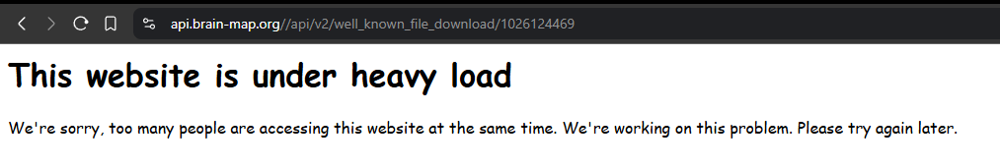

As you can see, the `session` object has a lot of attributes and methods that can be used to access the underlying data in the NWB file. Most of these will be touched on in other sections, but for now we will look at the only one that is capable of triggering additional data downloads, `get_lfp()`.

In general, each NWB file is meant to be a self-contained repository of data for one recording session. However, for the Neuropixels data, we've broken with convention a bit in order to store LFP data in separate files. If we hadn't done this, analyzing one session would require an initial 15 GB file download. Now, the session is broken up in to ~2 GB chunks..

Once you have created a `session` object, downloading the LFP data is simple (but may be slow):

In [ ]:
session.probes

,description,location,sampling_rate,lfp_sampling_rate,has_lfp_data
id,,,,,
810755797,probeA,See electrode locations,29999.954846,1249.998119,True
810755799,probeB,See electrode locations,29999.906318,1249.996097,True
810755801,probeC,See electrode locations,29999.985470,1249.999395,True
810755803,probeD,See electrode locations,29999.908100,1249.996171,True
810755805,probeE,See electrode locations,29999.985679,1249.999403,True
810755807,probeF,See electrode locations,30000.028033,1250.001168,True


In [ ]:
probe_id = session.probes[session.probes.description == 'probeE'].index.values[0]
lfp = session.get_lfp(probe_id)

/usr/local/lib/python3.11/dist-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'hdmf-common' version 1.1.3 because version 1.8.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/usr/local/lib/python3.11/dist-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.2.2 because version 2.7.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."


Downloading:   0%|          | 0.00/2.46G [00:00<?, ?B/s]

/usr/local/lib/python3.11/dist-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'hdmf-common' version 1.1.3 because version 1.8.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/usr/local/lib/python3.11/dist-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.2.2 because version 2.7.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."


# Downloading the whole dataset

Analyzing one session at a time is nice, but in many case you'll want to be able to query across the whole dataset. To fill your cache with all available data, you can use a `for` loop like the one below. Note that we've added some checks to ensure that the complete file is present, in case the download has been interrupted due to an unreliable connection.

Before running this code, please make sure that you have enough space available in your cache directory. You'll need around 855 GB for the whole dataset, and 147 GB if you're not downloading the LFP data files.

```python
if DOWNLOAD_COMPLETE_DATASET:
    for session_id, row in sessions.iterrows():

        truncated_file = True
        directory = os.path.join(output_dir + '/session_' + str(session_id))

        while truncated_file:
            session = cache.get_session_data(session_id)
            try:
                print(session.specimen_name)
                truncated_file = False
            except OSError:
                shutil.rmtree(directory)
                print(" Truncated spikes file, re-downloading")

        for probe_id, probe in session.probes.iterrows():

            print(' ' + probe.description)
            truncated_lfp = True

            while truncated_lfp:
                try:
                    lfp = session.get_lfp(probe_id)
                    truncated_lfp = False
                except OSError:
                    fname = directory + '/probe_' + str(probe_id) + '_lfp.nwb'
                    os.remove(fname)
                    print("  Truncated LFP file, re-downloading")
                except ValueError:
                    print("  LFP file not found.")
                    truncated_lfp = False
```

### Using AWS to access the data

If you want to analyze the data without downloading anything to your local machine, you can use the AllenSDK on AWS.

Follow [these instructions](https://github.com/AllenInstitute/AllenSDK/wiki/Use-the-Allen-Brain-Observatory-%E2%80%93-Visual-Coding-on-AWS) to launch a Jupyter notebook. Then, simply point to the existing manifest file in the Allen Institute's S3 bucket, and all of the data will be immediately available:

```python
cache = EcephysProjectCache(manifest=manifest_path)
```

Once your cache is initialized, you can create the `sessions` table, load individual `session` objects, and access LFP data using the same commands described above.

### Direct download via api.brain-map.org

Some people have reported issues downloading the files via the AllenSDK (the connection is extremely slow, or gets interrupted frequently). If this applies to you, you can try downloading the files via HTTP requests sent to **api.brain-map.org**. This approach is not recommended, because you will have to manually keep track of the file locations. But if you're doing analysis that doesn't depend on the AllenSDK (e.g., in Matlab), this may not matter to you.

You can follow the steps below to retrieve the URLs for all of the NWB files in this dataset.

```python
from allensdk.brain_observatory.ecephys.ecephys_project_api.utilities import build_and_execute
from allensdk.brain_observatory.ecephys.ecephys_project_api.rma_engine import RmaEngine
from allensdk.brain_observatory.ecephys.ecephys_project_cache import EcephysProjectCache

rma_engine = RmaEngine(scheme="http", host="api.brain-map.org")

cache = EcephysProjectCache.from_warehouse(manifest=manifest_path)

sessions = cache.get_session_table()

def retrieve_link(session_id):
    
    well_known_files = build_and_execute(
        (
        "criteria=model::WellKnownFile"
        ",rma::criteria,well_known_file_type[name$eq'EcephysNwb']"
        "[attachable_type$eq'EcephysSession']"
        r"[attachable_id$eq{{session_id}}]"
        ),
        engine=rma_engine.get_rma_tabular,
        session_id=session_id
    )
    
    return 'http://api.brain-map.org/' + well_known_files['download_link'].iloc[0]

download_links = [retrieve_link(session_id) for session_id in sessions.index.values]

_ = [print(link) for link in download_links]
```

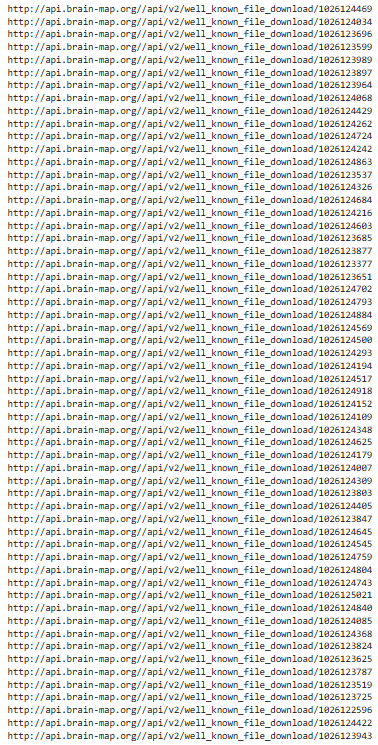

`download_links` is a list of 58 links that can be used to download the NWB files for all available sessions. Clicking on the links should start the download automatically.

Please keep in mind that you'll have to move these files to the appropriate sub-directory once the download is complete. The `EcephysProjectCache` object expects the following directory structure:

```
cache_dir/
+-- manifest.json               
+-- session_<id>/    
¦   +-- session_<id>.nwb
+-- session_<id>/
¦   +-- session_<id>.nwb
+-- session_<id>/
¦   +-- session_<id>.nwb

```

If you aren't interested in using the `EcephysProjectCache` object to keep track of what you've downloaded, you can create a `session` object just by passing a path to an NWB file:

```python
from allensdk.brain_observatory.ecephys.ecephys_session import EcephysSession

# nwb_path = '/mnt/nvme0/ecephys_cache_dir_10_31/session_721123822/session_721123822.nwb'

# session = EcephysSession.from_nwb_path(nwb_path, api_kwargs={
#         "amplitude_cutoff_maximum": np.inf,
#         "presence_ratio_minimum": -np.inf,
#         "isi_violations_maximum": np.inf
#     })
```

This will load the data for one session, without applying the default unit quality metric filters. Everything will be available except the LFP data, because the `get_lfp()` method can only find the associated LFP files if you're using the `EcephysProjectCache` object.

To obtain similar links for the LFP files, you can use the following code:

```python
def retrieve_lfp_link(probe_id):

    well_known_files = build_and_execute(
        (
            "criteria=model::WellKnownFile"
            ",rma::criteria,well_known_file_type[name$eq'EcephysLfpNwb']"
            "[attachable_type$eq'EcephysProbe']"
            r"[attachable_id$eq{{probe_id}}]"
        ),
        engine=rma_engine.get_rma_tabular,
        probe_id=probe_id
    )

    if well_known_files.shape[0] != 1:
        return 'file for probe ' + str(probe_id) + ' not found'
        
    return 'http://api.brain-map.org/' + well_known_files.loc[0, "download_link"]

probes = cache.get_probes()

download_links = [retrieve_lfp_link(probe_id) for probe_id in probes.index.values]

_ = [print(link) for link in download_links]
```

# Learning about probes

The `session` object contains all of the spike data for one recording session, as well as information about the stimulus, mouse behavior, and probes. To prevent the underlying NWB file from becoming too large, the LFP data is stored  separately, on a probe-by-probe basis. Before loading the LFP, let's take a look at the probes that are available for this session.

In [ ]:
session.probes

,description,location,sampling_rate,lfp_sampling_rate,has_lfp_data
id,,,,,
810755797,probeA,See electrode locations,29999.954846,1249.998119,True
810755799,probeB,See electrode locations,29999.906318,1249.996097,True
810755801,probeC,See electrode locations,29999.985470,1249.999395,True
810755803,probeD,See electrode locations,29999.908100,1249.996171,True
810755805,probeE,See electrode locations,29999.985679,1249.999403,True
810755807,probeF,See electrode locations,30000.028033,1250.001168,True


There are six probes available, and all of them have LFP data. Note that there is a small subset of probes across the entire dataset that only have spike data, due to high levels of electrical noise contamining the LFP band. To see which sessions are missing LFP data, you can check the `probes` table from the `EcephysProjectCache`:

In [ ]:
probes = cache.get_probes()

print('Fraction of probes with LFP: ' + str(np.around( np.sum(probes.has_lfp_data) / len(probes), 3) ) )
print(' ')
print('Sessions with missing LFP files: ' + str(list(probes[probes.has_lfp_data == False].ecephys_session_id.unique())))

Fraction of probes with LFP: 0.979
 
Sessions with missing LFP files: [763673393, 831882777, 839557629]


Returning to the current session, let's get some information about which brain regions each probe is recording from before we select LFP data to look at in more detail.

Each probe has a unique ID, but the "description" of each probe is assigned based on its location on the recording rig. The Allen Institute Neuropixels rigs have six slot for probes, which are named A, B, C, D, E, and F. The probes are arranged in a ring centered on visual cortex. Probe A is in the anterior/medial position, and the letters go clockwise around the ring.

To visualize what this looks like, we can access the spatial information in this session's `channels` table:

In [ ]:
session.channels.keys()

/usr/local/lib/python3.11/dist-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'hdmf-common' version 1.1.3 because version 1.8.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/usr/local/lib/python3.11/dist-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.2.2 because version 2.7.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."


Index(['filtering', 'probe_channel_number', 'probe_horizontal_position',
       'probe_id', 'probe_vertical_position', 'structure_acronym',
       'ecephys_structure_id', 'ecephys_structure_acronym',
       'anterior_posterior_ccf_coordinate', 'dorsal_ventral_ccf_coordinate',
       'left_right_ccf_coordinate'],
      dtype='object')

As you can see, the `channels` table mainly contains columns related to the physical locations, either relative to the probe shank (`probe_vertical_position` and `probe_horizontal_position`), or relative to the Allen Common Coordinate Framework (`anterior_posterior_ccf_coordinate`, `dorsal_ventral_ccf_coordinate`, and `left_right_ccf_coordinate`). Let's use a combination of these to visualize the locations of the probes in this recording.

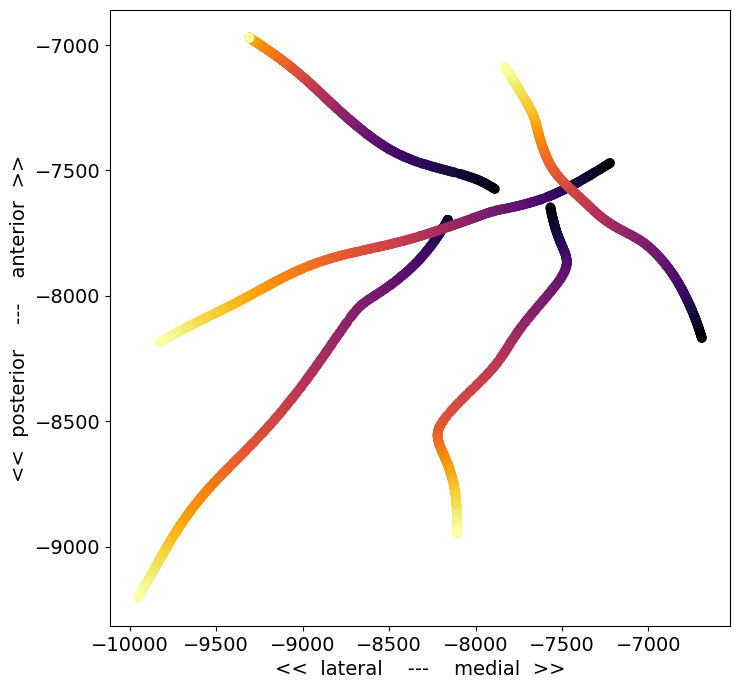

In [ ]:
plt.rcParams.update({'font.size': 14})

x_coords = session.channels.left_right_ccf_coordinate
y_coords = session.channels.anterior_posterior_ccf_coordinate
color = session.channels.probe_vertical_position

plt.figure(figsize=(8,8))
_ = plt.scatter(-x_coords[x_coords > 0], -y_coords[x_coords > 0], c=color[x_coords > 0], cmap='inferno')
_ = plt.xlabel('<<  lateral    ---    medial  >>')
_ = plt.ylabel('<<  posterior    ---    anterior  >>')

This is a top-down view of the locations of each channel, with the color corresponding to distance along the probe axis (darker = deeper in the brain). A few things to note about this plot:

* There are only 5 probes visible, even though there were 6 probes in the recording. This is because one of the probes was not visible in the optical projection tomography volume we use to identify the recording location. If this occurs, the probe will be assigned a 3D CCF coordinate of [-1, -1, -1], and only cortical units will be given an `ecephys_structure_acronym`.
* The probe trajectories are curved, as a result of warping to the CCF template brain. The trajectories are straight in the original brain volume.
* Some of the probes appear longer than others. This may be due to the viewing angle (in this plot, the more lateral probes are viewed more perpendicular to the insertion axis), or the fact that probes may be inserted to different depths.

To figure out which probe is missing, we can check the `probes` table for this session:

In [ ]:
session.probes.loc[np.unique(session.channels.probe_id.values[x_coords > 0])].description.values

array(['probeA', 'probeC', 'probeD', 'probeE', 'probeF'], dtype=object)

It looks like `probeB` was not registered to the CCF. That means that `probeA` is in the upper right, `probeC` is in the lower right, and `D`, `E`, and `F` go clockwise from there. It's helpful to keep these descriptions in mind, because probes with the same descriptions enter the brain at roughly the same angle across experiments. Although the precise target point for each probe depends on the retinotopic map for each mouse, the overall rig geometry remains the same across sessions.

Let's look at the structures each of these probes passes through:

In [ ]:
{session.probes.loc[probe_id].description :
     list(session.channels[session.channels.probe_id == probe_id].ecephys_structure_acronym.unique())
     for probe_id in session.probes.index.values}

{'probeA': ['VISam', nan, 'APN', 'MB', 'DG', 'CA1'],
 'probeB': ['grey', nan, 'VISpm'],
 'probeC': ['PO', 'PoT', 'LP', 'DG', 'CA1', 'VISp', nan],
 'probeD': ['LGd', 'CA3', 'DG', 'CA1', 'VISl', nan],
 'probeE': ['PO', 'LP', 'LGd', 'CA3', 'DG', 'CA1', 'VISrl', nan],
 'probeF': ['CA1', 'VISrl', nan]}

In general, probes tend to be inserted through cortex (`VIS` structures), into to hippocampus (`CA1`, `CA3`, `DG`), and down into the thalamus or midbrain. If there's no CCF registration available (e.g., for `probeB` in this example), subcortical structures are marked as `grey`.

In [ ]:
!curl -L "https://drive.google.com/uc?export=download&id=1Q9zJUp4IMFY7wTtaFb10NB-mVDg9Xha4" > probes.gif

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
  0     0    0     0    0     0      0      0 --:--:-- --:--:-- --:--:--     0
100 18.7M  100 18.7M    0     0  3044k      0  0:00:06  0:00:06 --:--:-- 4909k


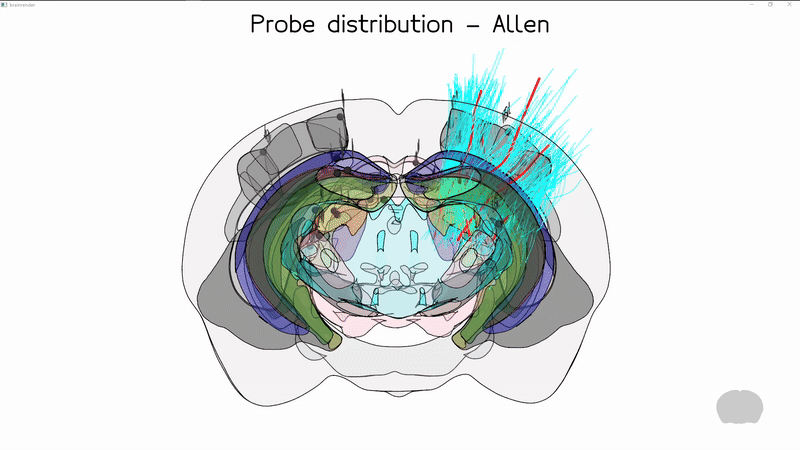

In [ ]:
from IPython.display import Image
Image('/content/probes.gif')

Refer to [Allen Brain Atlas](https://mouse.brain-map.org/static/atlas) for more details on brain regions.

# Loading LFP data

Now that we've seen a general overview of how the probes are oriented and what structures they pass through, let's choose one and load its associated LFP data:

In [ ]:
probe_id = session.probes[session.probes.description == 'probeE'].index.values[0]
print(f"Probe ID: {probe_id}")
# lfp = session.get_lfp(probe_id)

Probe ID: 810755805


If you haven't tried to access this data previously, you'll have to wait while the LFP NWB file downloads. Even if you already have the data stored locally, it may still take a minute to load, since the LFP data is quite large.

Once the data is loaded, we can take a closer look at the `lfp` object:

In [ ]:
lfp

<xarray.DataArray 'LFP' (time: 12028993, channel: 95)>
array([[-2.43750e-05, -3.08100e-05, -3.19800e-05, ..., -1.95000e-07,
        -1.34550e-05, -1.15050e-05],
       [-4.44600e-05, -3.31500e-05, -1.42350e-05, ...,  1.95000e-06,
        -2.49600e-05, -1.34550e-05],
       [-4.58250e-05,  1.17000e-06, -1.42350e-05, ...,  1.36500e-06,
        -1.03350e-05, -1.71600e-05],
       ...,
       [-9.59400e-05, -1.54245e-04, -1.06275e-04, ...,  4.89450e-05,
         0.00000e+00,  4.09500e-06],
       [-1.93050e-05, -7.17600e-05, -4.25100e-05, ...,  6.10350e-05,
        -9.75000e-07,  1.15050e-05],
       [-2.73000e-05, -7.21500e-05, -6.24000e-05, ...,  3.04200e-05,
        -1.95000e-06, -1.95000e-07]], dtype=float32)
Coordinates:
  * time     (time) float64 13.58 13.58 13.58 ... 9.637e+03 9.637e+03 9.637e+03
  * channel  (channel) int64 850258492 850258500 ... 850259236 850259244

The LFP data is stored as an [xarray.DataArray](http://xarray.pydata.org/en/stable/) object, with coordinates of `time` and `channel`. The xarray library simplifies the process of working with N-dimensional data arrays, by keeping track of the meaning of each axis.

If this is your first time encountering xarrays, I strongly recommend reading through the [documentation](http://xarray.pydata.org/en/stable/quick-overview.html) before going further. Getting used to xarrays can be frustrating, especially when they don't behave like numpy arrays. But they are designed to prevent common mistakes when analyzing multidimensional arrays, so they are well worth learning more about. Plus, the syntax is modeled on that of the [pandas](https://pandas.pydata.org/) library, so if you're familiar with that you already have a head start.

The print-out above already tells us a lot about what the `lfp` object contains. It stores an array with around 12 million points along the `time` axis and 95 points along the `channel` axis. The `time` axis ranges from 13.5 to around 9600 seconds, while the `channel` axis ranges from 850258492 to 850259244 (these are the unique IDs for each channel).

Let's use the `DataArray.sel()` method to select a slice through this array between 100 and 101 seconds:

In [ ]:
lfp_slice = lfp.sel(time=slice(100,101))
lfp_slice

<xarray.DataArray 'LFP' (time: 1250, channel: 95)>
array([[ 1.50149994e-04,  1.49954998e-04,  1.65749996e-04, ...,
         4.68000007e-06,  2.30099995e-05, -1.13099995e-05],
       [ 1.64190002e-04,  1.41569995e-04,  1.50734995e-04, ...,
         6.62999992e-06,  1.18950002e-05, -1.30649996e-05],
       [ 1.43519996e-04,  1.47030005e-04,  1.80959993e-04, ...,
         4.48499986e-06,  1.96950004e-05,  8.18999979e-06],
       ...,
       [-2.35949992e-05, -1.63799996e-05, -3.45150002e-05, ...,
         1.55999999e-06, -1.48199997e-05, -1.11150002e-05],
       [-1.87200003e-05, -5.75249978e-05, -4.93349980e-05, ...,
         8.38500000e-06, -2.00849991e-05, -5.26499980e-06],
       [-3.17849990e-05, -5.53799982e-05, -4.17299998e-05, ...,
         2.14500005e-06, -1.67700000e-05, -2.73000001e-06]], dtype=float32)
Coordinates:
  * time     (time) float64 100.0 100.0 100.0 100.0 ... 101.0 101.0 101.0 101.0
  * channel  (channel) int64 850258492 850258500 ... 850259236 850259244

We see that this new DataArray is smaller than before; it contains the same number of channels, but only 1250 samples, due to the LFP sample rate of ~1250 Hz.

Let's plot the data for one of the channels:

Text(0, 0.5, 'LFP (V)')

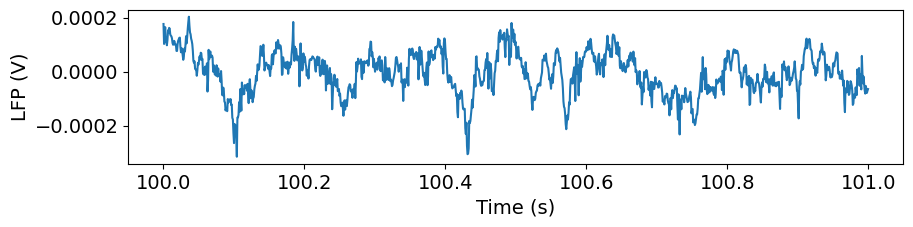

In [ ]:
plt.figure(figsize=(10,2))
_ = plt.plot(lfp_slice.time, lfp_slice.sel(channel=lfp_slice.channel[10]))
plt.xlabel('Time (s)')
plt.ylabel('LFP (V)')

Alternatively, we can visualize this slice  of data using matplotlib's `imshow` method:

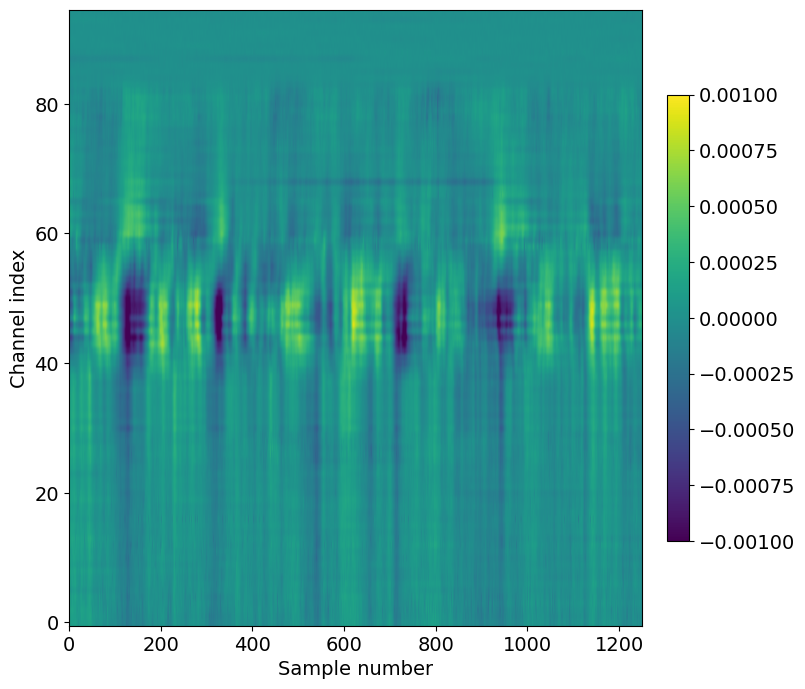

In [ ]:
plt.figure(figsize=(8,8))
im = plt.imshow(lfp_slice.T,aspect='auto',origin='lower',vmin=-1e-3, vmax=1e-3)
_ = plt.colorbar(im, fraction=0.036, pad=0.04)
_ = plt.xlabel('Sample number')
_ = plt.ylabel('Channel index')

Note that we've transposed the original array to place the time dimension along the x-axis. We've also configured the plot so that the origin of the array is in the lower-left, so that that channels closer to the probe tip are lower in the image.

A few things to note about this plot:

* The units of the LFP are volts, so the color scale ranges from -1 to +1 mV
* Even though there are 384 channels on the Neuropixels probe, there are only 95 channels in this plot. That's because only every 4th channel is included in the NWB file (resulting in 40 micron vertical spacing). In addition, the reference channels and channels far outside the brain have been removed.
* The top of the plot is relatively flat. This corresponds to channels that are outside the brain. The LFP channels are originally referenced to a ground wire embedded in the ACSF/agarose mixture about cortex. Before NWB packaging, the LFP data is digitally referenced to the channels outside the brain, to remove noise that's shared across the whole probe.
* There's a large increase in LFP power toward the middle of the probe, which corresponds to channels in hippocampus.

Let's do some additional data selection to look at just the hippocampal channels from this recording.

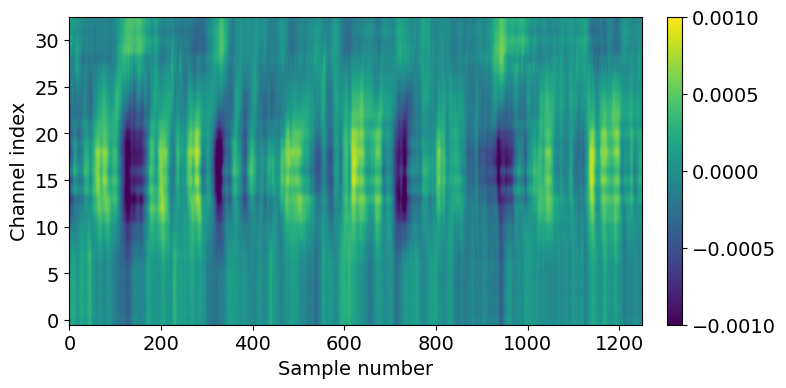

In [ ]:
channel_ids = session.channels[(session.channels.probe_id == probe_id) & \
                 (session.channels.ecephys_structure_acronym.isin(['CA1','CA3','DG']))].index.values

lfp_slice2 = lfp_slice.sel(channel=slice(np.min(channel_ids), np.max(channel_ids)))

plt.figure(figsize=(8,4))
im = plt.imshow(lfp_slice2.T,aspect='auto',origin='lower',vmin=-1e-3, vmax=1e-3)
_ = plt.colorbar(im, fraction=0.036, pad=0.04)
_ = plt.xlabel('Sample number')
_ = plt.ylabel('Channel index')

# Aligning LFP data to a stimulus

In the above example, we selected LFP data based on an arbitrary time span (100 to 101 seconds). For many analyses, however, we'll want to align the data to the onset of a particular type of stimulus.

The AllenSDK provides a number of convenience functions for aligning spikes to visual stimuli.

First, we need to select some stimulus presentations to use:

In [ ]:
session.stimulus_presentations['stimulus_name'].unique()

array(['spontaneous', 'gabors', 'flashes', 'drifting_gratings',
       'natural_movie_three', 'natural_movie_one', 'static_gratings',
       'natural_scenes'], dtype=object)

In [ ]:
presentation_table = session.stimulus_presentations[session.stimulus_presentations.stimulus_name == 'flashes']

presentation_times = presentation_table.start_time.values
presentation_ids = presentation_table.index.values

In [ ]:
trial_window = np.arange(-0.5, 0.5, 1/500)
time_selection = np.concatenate([trial_window + t for t in presentation_times])

inds = pd.MultiIndex.from_product((presentation_ids, trial_window),
                                  names=('presentation_id', 'time_from_presentation_onset'))

ds = lfp.sel(time = time_selection, method='nearest').to_dataset(name = 'aligned_lfp')
ds = ds.assign(time=inds).unstack('time')

aligned_lfp = ds['aligned_lfp']

`aligned_lfp` is a DataArray with dimensions of channels x trials x time. It's been downsampled to 500 Hz by changing the time step in the `trial_window` variable.

Because we're using xarrays, the alignment operation is fast, and doesn't require any `for` loops! There's a lot going on here, so we recommend referring to the pandas and xarray documentation if anything is confusing.

Now we can visualize the average LFP, aligned to the trial onset:

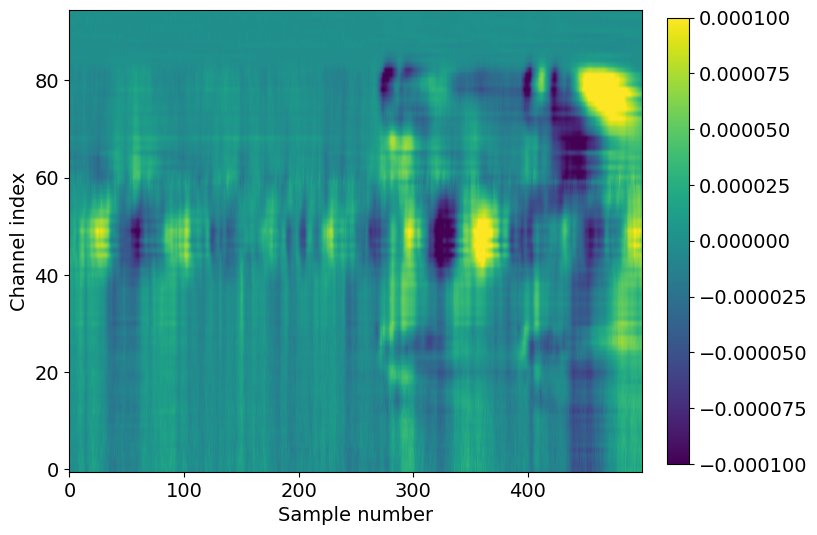

In [ ]:
plt.figure(figsize=(8,6))
im = plt.imshow(aligned_lfp.mean(dim='presentation_id'), aspect='auto', origin='lower', vmin=-1e-4, vmax=1e-4)
_ = plt.colorbar(im, fraction=0.036, pad=0.04)
_ = plt.xlabel('Sample number')
_ = plt.ylabel('Channel index')

Here we see the effect of a 250 ms flash stimulus on the LFP. There are two large responses in cortex (channel index 60-80), one corresponding to the stimulus onset (around sample 280), and one corresponding to the stimulus offset (around sample 400).

Note that the voltage range is an order of magnitude less than it was for the single-trial LFP, around -100 to +100 microvolts.

You can use the code sample above to align the LFP to any type of event (e.g. spike times, running onset, optogenetic stimuli) just by changing the `trial_window` and `time_selection` variables.

# Aligning LFP data to units (neurons?)

What if we want to extract the LFP at a particular location in space, corresponding to the location of a unit we're analyzing?

Let's start by finding a well-isolated, high-firing rate unit in visual cortex from the probe we're currently working with.

Once we've selected a unit of interest, the xarray library makes it easy to find the associated LFP channel.

In [ ]:
units_of_interest = session.units[(session.units.probe_id == probe_id) &
                                  (session.units.ecephys_structure_acronym.str.find('VIS') > -1) &
                                  (session.units.firing_rate > 10) &
                                  (session.units.nn_hit_rate > 0.95)]

len(units_of_interest)

/usr/local/lib/python3.11/dist-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'hdmf-common' version 1.1.3 because version 1.8.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/usr/local/lib/python3.11/dist-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.2.2 because version 2.7.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."


4

There are four units that meet our criteria. Let's choose one and find its associated channel index.

In [ ]:
unit_id = units_of_interest.index.values[0]
channel_index = units_of_interest.loc[unit_id].probe_channel_number
channel_index

260

Note that this is the channel index relative to the original probe (out of 384 possible channels), rather than the index of the LFP DataArray.

We can now use the channel index to find the unique channel ID for this unit:

In [ ]:
channel_id = session.channels[(session.channels.probe_channel_number == channel_index) &
                              (session.channels.probe_id == probe_id)].index.values[0]
channel_id

850259008

Using `unit_id` and `channel_id`, we can select the spikes and LFP within an arbitrary time interval. Note that we need to use `method='nearest'` when selecting the LFP data channel, since not every electrode is included in the LFP DataArray.

In [ ]:
start_time = 500
end_time = 510

spike_times = session.spike_times[unit_id]

times_in_range = spike_times[(spike_times > start_time) & (spike_times < end_time)]

lfp_data = lfp.sel(time = slice(start_time, end_time))
lfp_data = lfp_data.sel(channel = channel_id, method='nearest')

/usr/local/lib/python3.11/dist-packages/allensdk/brain_observatory/ecephys/ecephys_session.py:1371: UserWarning: Session includes invalid time intervals that could be accessed with the attribute 'invalid_times',Spikes within these intervals are invalid and may need to be excluded from the analysis.
  warnings.warn("Session includes invalid time intervals that could "
/usr/local/lib/python3.11/dist-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'hdmf-common' version 1.1.3 because version 1.8.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/usr/local/lib/python3.11/dist-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.2.2 because version 2.7.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."


Finally, we can plot the spike times along with the LFP for this interval:

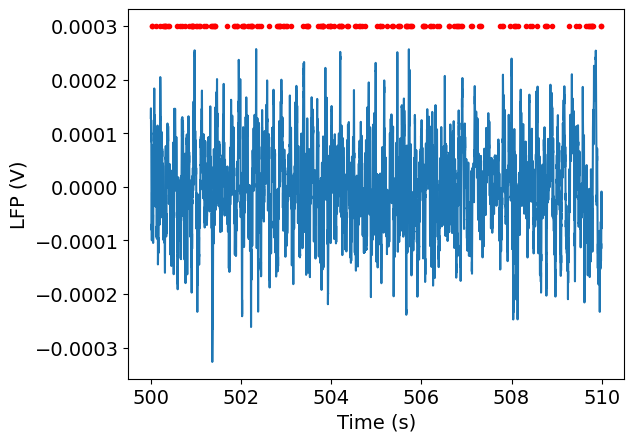

In [ ]:
_ = plt.plot(lfp_data.time, lfp_data)
_ = plt.plot(times_in_range, np.ones(times_in_range.shape)*3e-4, '.r')
_ = plt.xlabel('Time (s)')
_ = plt.ylabel('LFP (V)')

# Current Source Density

LFP data is commonly used to generate current source density (CSD) plots, which show the location of current sources and sinks along the probe axis. CSD analysis benefits from high spatial resolution, since it involves taking the second spatial derivative of the data. Because of Neuropixels dense site spacing, these probes are optimal for computing the CSD. However, the LFP data available through the AllenSDK has been spatially downsampled prior to NWB packaging.

To provide access to a high-resolution CSD plot, Allen Institute has pre-computed the CSD in response to a flash stimulus for all probes with LFP.

In [ ]:
csd = session.get_current_source_density(probe_id)
csd

/usr/local/lib/python3.11/dist-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'hdmf-common' version 1.1.3 because version 1.8.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/usr/local/lib/python3.11/dist-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.2.2 because version 2.7.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."


<xarray.DataArray 'CSD' (virtual_channel_index: 384, time: 875)>
array([[  58327.03371574,   20117.6298887 ,  -14617.79294315, ...,
        -179410.38257756, -140541.81597896,  -99855.52022176],
       [ -65434.3204571 ,  -32932.62888488,   -3367.24904473, ...,
         161433.08930627,  136244.74051173,  109671.1407354 ],
       [  28505.59773412,   31288.43801342,   33892.68350592, ...,
          39946.37351702,   24588.34919833,    8571.48977541],
       ...,
       [  -3201.28149464,   -1289.03683893,     502.04419085, ...,
           -943.9933153 ,   -2669.37931577,   -4375.39738216],
       [ -32827.35201643,  -16409.56190898,   -1052.05581321, ...,
        -106129.85783238,  -94380.54770586,  -82251.01882374],
       [  34153.87655675,   16950.77633742,     815.89811501, ...,
          94579.10700446,   89217.81476538,   83741.3728981 ]])
Coordinates:
  * virtual_channel_index  (virtual_channel_index) int64 0 1 2 3 ... 381 382 383
  * time                   (time) float64 -0.1 -0.0996 -0.0992 ... 0.2492 0.2496
    vertical_position      (virtual_channel_index) float64 0.0 10.0 ... 3.83e+03
    horizontal_position    (virtual_channel_index) float64 24.0 24.0 ... 24.0

The `CSD` object is a DataArray with dimensions of channels x time. Note that the channels are actually "virtual channels," based on interpolated signals along the central axis of the probe, with 10 micron inter-site spacing.

<Figure size 1000x1000 with 0 Axes>

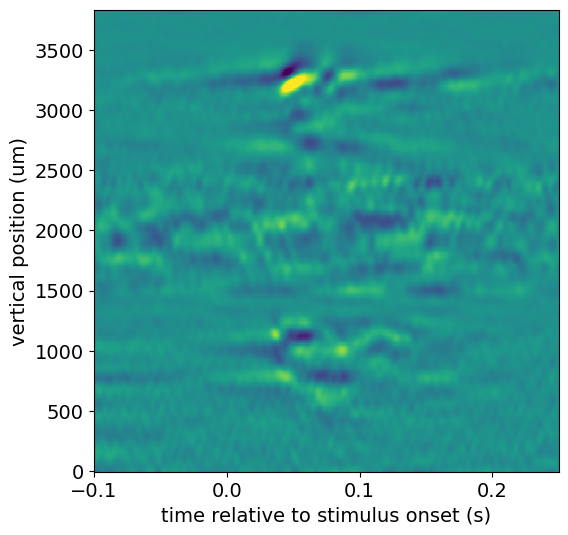

In [ ]:
_ = plt.figure(figsize=(10,10))

filtered_csd = gaussian_filter(csd.data, sigma=(5,1))

fig, ax = plt.subplots(figsize=(6, 6))

_ = ax.pcolor(csd["time"], csd["vertical_position"], filtered_csd, vmin=-3e4, vmax=3e4)

_ = ax.set_xlabel("time relative to stimulus onset (s)")
_ = ax.set_ylabel("vertical position (um)")

This CSD shows a clear stimulus-evoked response in cortex (2600-3500 microns), with an even earlier response in a subcortical region (700-1200 microns).

We can use the `channels` table to figure out where this signal is coming from:

In [ ]:
list(session.channels[(session.channels.probe_id == probe_id) &
                 (session.channels.probe_vertical_position > 700) &
                 (session.channels.probe_vertical_position < 1200)].ecephys_structure_acronym.unique())

['LP', 'LGd']

It looks like this region of the probe is on the border between LGd and LP nuclei in the thalamus.

# Unit quality metrics

### Why?

For a long time, converting continuous voltage traces to sorted spike times was one of the "dark arts" of neuroscience. Spikes were typically sorted by hand-drawing boundaries around clouds of dots, using heuristics learned from other lab members. The quality of the resulting clusters could be validated by looking at metrics such as ISI violations or isolation distance, but there were no standards governing how these metrics informed which units to include for further analysis.

Recent in advances in neural recording devices, such as Neuropixels, have made it practically impossible to sort spikes by hand. Fortunately, we now have access to powerful algorithms that use GPUs to sort spikes in approximately the same amount of time it took to record the data. All of the Allen Institute Neuropixels data has been sorted with [Kilosort2](https://github.com/MouseLand/Kilosort2), a template-matching algorithm developed by Marius Pachitariu at HHMI Janelia Research Campus.

For Neuropixels recordings with minimal electrode drift, Kilosort2 performs well enough that further manual curation is not necessary. Unlike the original version of Kilosort, which required a manual merging step, Kilosort2 attempts to merge units automatically. Sometimes it over-merges, leading to units that clearly combine spikes from multiple cells. But in the majority of cases, Kilosort2 makes merging decisions as well as a human would, and does so in a way that is highly reproducible.

Because there is no "ground truth" information available in these datasets, any sorting algorithm is bound to make mistakes. Quality metrics allow us to understand the types of mistakes that are occurring, and obtain an estimate of their severity. Some common errors that can be identified by quality metrics include:

* Assigning spikes from multiple neurons to the same cluster
* Missing spikes from neurons with waveform amplitude near the spike detection threshold
* Failing to track neurons with waveforms that change as a result of electrode drift

These mistakes can occur even in units that appear to be extremely well isolated. It's misleading to conceive of units as existing in two distinct categories, one with perfectly clean "single units" and one with impure "multiunits." Instead, there's a gradient of qualities, with mostly complete, uncontaminated units at one end, and incomplete, highly contaminated units at the other.

Despite the fact that there's not a clear division between single-unit and multi-unit activity, we still have to make a binary decision in every analysis we carry out: should this unit be included or not? Ideally this decision should be based on objective metrics that will not bias the end results. By default, the AllenSDK uses three quality metrics, `isi_violations`, `amplitude_cutoff`, and `presence_ratio`, to filter out units that are likely to be highly contaminated or missing lots of spikes. However, the default values of these filters may not be appropriate for your analysis, or you may want to disable them entirely.

### How?

The Python code used to calculate these metrics from the outputs of Kilosort2 is available in the [ecephys_spike_sorting](https://github.com/AllenInstitute/ecephys_spike_sorting/tree/master/ecephys_spike_sorting/modules/quality_metrics) repository. A number of the metrics are based on the waveform principal components, which are not included in the data release. To recompute these metrics on your own, you'll need access to the raw data, which is available in the [Allen Brain Observatory S3 Bucket on AWS](https://registry.opendata.aws/allen-brain-observatory/).

This code was recently incorporated into the [SpikeMetrics](https://github.com/SpikeInterface/spikemetrics) repository by the SpikeInterface team. It's now available as a PyPi package (`pip install spikemetrics`) if you'd like to try them out on your own data.

In [ ]:
units = cache.get_units(amplitude_cutoff_maximum = np.inf,
                        presence_ratio_minimum = -np.inf,
                        isi_violations_maximum = np.inf)
len(units)

99180

Now we have a DataFrame that contains all of the units detected by Kilosort2 across 58 experiments. Importantly, this does not include units with invalid waveforms. Kilosort2 often detects "spikes" that are very clearly not associated with action potentials; these can result from electrical artifacts or lower-frequency voltage fluctuations that cross the spike detection threshold. The majority of these "noise" units are automatically filtered out via [this module](https://github.com/AllenInstitute/ecephys_spike_sorting/tree/master/ecephys_spike_sorting/modules/noise_templates), followed by a manual inspection step to identify any remaining artifactual waveforms.

Let's look in more detail at the distribution of some quality metrics across 99,180 units. We'll start by creating a function for plotting each metric in an aesthetically pleasing way:

In [ ]:
plt.rcParams.update({'font.size': 14})

def plot_metric(data, bins, x_axis_label, color, max_value=-1):

    h, b = np.histogram(data, bins=bins, density=True)

    x = b[:-1]
    y = gaussian_filter1d(h, 1)

    plt.plot(x, y, color=color)
    plt.xlabel(x_axis_label)
    plt.gca().get_yaxis().set_visible(False)
    [plt.gca().spines[loc].set_visible(False) for loc in ['right', 'top', 'left']]
    if max_value < np.max(y) * 1.1:
        max_value = np.max(y) * 1.1
    plt.ylim([0, max_value])

    return max_value

### Firing Rate

First, let's take a look at firing rate, which is the most straightforward metric to compute. Firing rate is equal to the total number of spikes divided by the number of seconds in the recording. We'll create a density plot of firing rate across all units in the dataset:

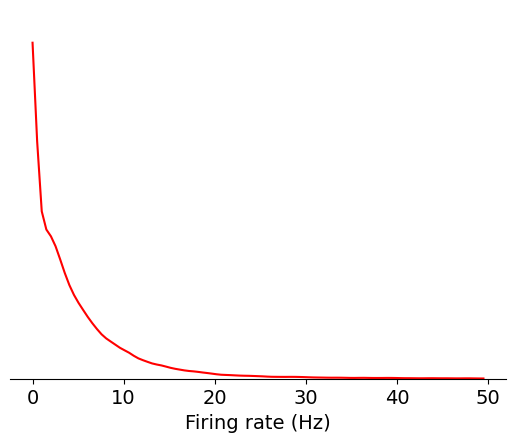

In [ ]:
data = units['firing_rate']
bins = np.linspace(0,50,100)

max_value = plot_metric(data, bins, 'Firing rate (Hz)', 'red')

Since there are many units with low firing rates, let's use a log scale instead:

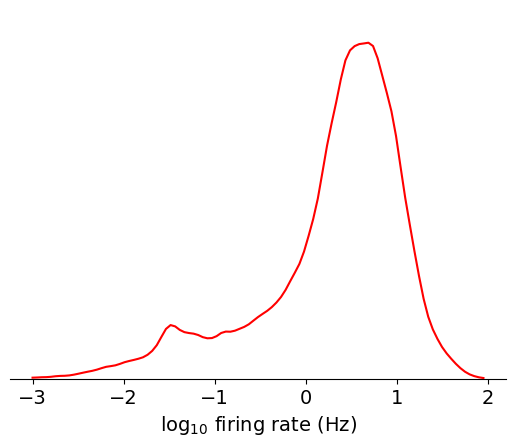

In [ ]:
data = np.log10(units['firing_rate'])
bins = np.linspace(-3,2,100)

max_value = plot_metric(data, bins, 'log$_{10}$ firing rate (Hz)', 'red')

Based on this plot, you can clearly see the approximately lognormal distribution of firing rates, which [has been described previously](http://www.buzsakilab.com/content/PDFs/Mizuseki2014.pdf). However, there's more weight on the lower tail of the distribution, which is likely due to some units missing spikes as a result of thresholding or drift. If we filter out contaminated units using another metric, `nn_hit_rate` (more on what this means later), the distribution becomes almost perfectly lognormal:

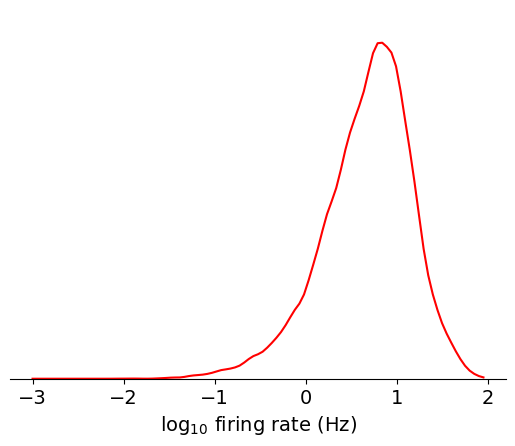

In [ ]:
data = np.log10(units[units.nn_hit_rate > 0.9]['firing_rate'])
bins = np.linspace(-3,2,100)

max_value = plot_metric(data, bins, 'log$_{10}$ firing rate (Hz)', 'red')

Before we move on to the next metric, let's add one more feature to these plots. Displaying the metrics separately for different brain regions can be helpful for understanding the variation that results from the physiological features of the area we're recording from. The four main regions that are part of the Neuropixels Visual Coding dataset are cortex, thalamus, hippocampus, and midbrain. We'll use the Allen CCF structure acronyms to find the units that belong to each region.

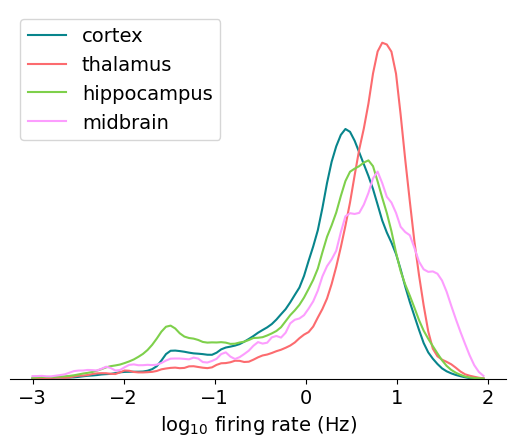

In [ ]:
region_dict = {'cortex' : ['VISp', 'VISl', 'VISrl', 'VISam', 'VISpm', 'VIS', 'VISal','VISmma','VISmmp','VISli'],
             'thalamus' : ['LGd','LD', 'LP', 'VPM', 'TH', 'MGm','MGv','MGd','PO','LGv','VL',
              'VPL','POL','Eth','PoT','PP','PIL','IntG','IGL','SGN','VPL','PF','RT'],
             'hippocampus' : ['CA1', 'CA2','CA3', 'DG', 'SUB', 'POST','PRE','ProS','HPF'],
             'midbrain': ['MB','SCig','SCiw','SCsg','SCzo','PPT','APN','NOT','MRN','OP','LT','RPF','CP']}

color_dict = {'cortex' : '#08858C',
              'thalamus' : '#FC6B6F',
              'hippocampus' : '#7ED04B',
              'midbrain' : '#FC9DFE'}

bins = np.linspace(-3,2,100)
max_value = -np.inf

for idx, region in enumerate(region_dict.keys()):

    data = np.log10(units[units.ecephys_structure_acronym.isin(region_dict[region])]['firing_rate'])

    max_value = plot_metric(data, bins, 'log$_{10}$ firing rate (Hz)', color_dict[region], max_value)

_ = plt.legend(region_dict.keys())

We can see a clear separation in the distributions across areas; the thalamus has a lot of units that fire in the 8 Hz range (remember the log scale), while the midbrain has the most units with very high rates (>20 Hz).

Here's a summary of things to keep in mind when using `firing_rate` in your analysis:

**How it can be biased**
* If a unit is poorly isolated, the firing rate will be over-estimated, because contaminating spikes will be included in the calculation
* If a unit's amplitude is close to threshold, the firing rate will be under-estimated, because some spikes will be missing
* If a unit drifts out of the recording, the firing rate will be under-estimated, because spikes will not be detected for a portion of the recording
* If data acquisition is interrupted (true for a small subset of experiments), the firing rate will be under-estimated, because spikes will be missing from gaps in the recording

**How it should be used**
* Firing rate can be used to filter out units that have too few spikes to result in meaningful analysis. In this case, it may be better to use the firing rate for the specific interval you're analyzing, because some units may drift out of the recording at other times.
* High firing rate units tend to be easier to isolate, since there are more spikes available for fitting the template in Kilosort2. However, there are other metrics that measure isolation more directly and would likely to be better to use instead.

### Presence ratio

Presence ratio is not a standard metric in the field, but it's straightforward to calculate and is an easy way to identify incomplete units. It measures the fraction of time during a session in which a unit is spiking, and ranges from 0 to 0.99 (an off-by-one error in the calculation ensures that it will never reach 1.0).

Let's look at the distribution of presence ratio across areas:

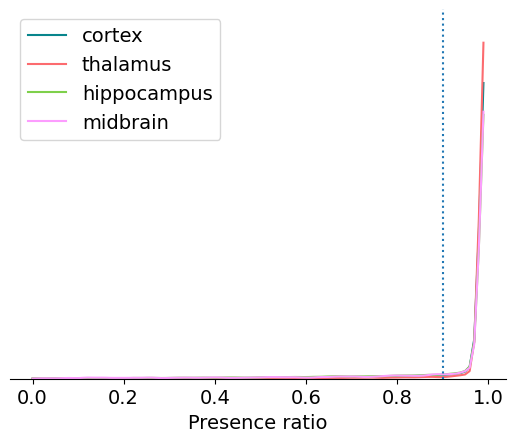

In [ ]:
bins = np.linspace(0,1,100)
max_value = -np.inf

for idx, region in enumerate(region_dict.keys()):

    data = units[units.ecephys_structure_acronym.isin(region_dict[region])]['presence_ratio']

    max_value = plot_metric(data, bins, 'Presence ratio', color_dict[region], max_value)

_ = plt.legend(region_dict.keys())

plt.plot([0.9, 0.9],[0,max_value], ':')

It's clear that most units have a presence ratio of 0.9 or higher, which means they are present for at least 90% of the recording. Units with lower presence ratio are likely to have drifted out of the recording, or had waveforms that changed so dramatically they were assigend to separate clusters.

Calculating the exact fraction of units with presence ratio above 0.9 is easy:

In [ ]:
np.around(np.sum(units.presence_ratio > 0.9) / len(units), 2)

0.83

Here's a summary of things to keep in mind when using `presence_ratio` in your analysis:

**How it can be biased**
* Just because a unit has a high presence ratio doesn't mean it's immune to drift. If a unit's amplitude drifts closer to the spike detection threshold, it can result in dramatic changes in apparent firing rate, even if the underlying physiology remains the same.
* Sometimes a low presence ratio can result from highly selective spiking patterns (e.g., firing only during running epochs)

**How it should be used**
* If you are analyzing changes in firing rate over the entire recording session, or are comparing responses to stimuli presented at the beginning and end of the experiment, presence ratio is a simple way to exclude units that would bias your results. However, you should also look at other quality metrics, such as <a href='#Amplitude-cutoff'>amplitude cutoff</a>, to check for more subtle effects of electrode drift.
* If you are only analyzing a short segment of the experiment, it may be helpful to disable the default presence ratio filter, in order to maximize the number of units available to you.
* If you're unsure whether a unit has a low presence ratio due to electrode drift or selective firing, plotting its spike amplitudes over time can be informative.

### Amplitude cutoff

Amplitude cutoff provides another way to check for units that are missing spikes. Unlike presence ratio, which detects units that drift out of the recording, amplitude cutoff provides an estimate of the false negative rate—e.g., the fraction of spikes below the spike detection threshold. Thus, amplitude cutoff is a measure of unit "completeness" that is complementary to presence ratio.

Let's take a look at the distribution of values for amplitude cutoff across the dataset:

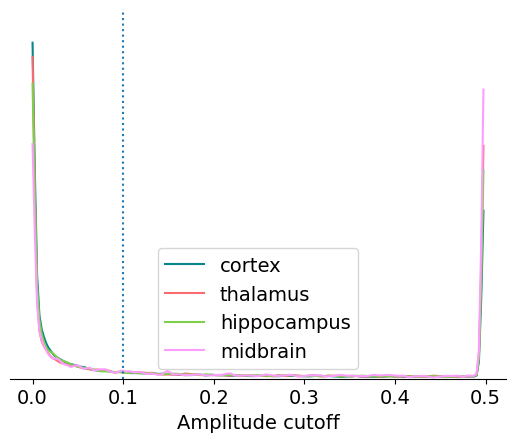

In [ ]:
bins = np.linspace(0,0.5,200)
max_value = -np.inf

for idx, region in enumerate(region_dict.keys()):

    data = units[units.ecephys_structure_acronym.isin(region_dict[region])]['amplitude_cutoff']

    max_value = plot_metric(data, bins, 'Amplitude cutoff', color_dict[region], max_value)

_ = plt.legend(region_dict.keys())

plt.plot([0.1, 0.1],[0,max_value], ':')

Amplitude cutoff is calculated from the distribution of spike amplitudes for each unit. This metric measures the degree to which this distribution is truncated, or "cut off," as a proxy for the fraction of missing spikes. So an amplitude cutoff of, say, 0.1 would indicate that approximately 10% of spikes are missing from this unit.

If the peak of the amplitude distribution occurs at its lowest value, it's impossible to estimate the fraction of missing spikes. In this case, the amplitude cutoff is set to 0.5. That explains why there are large peaks at both ends of the distribution, one around 0 and one at 0.5.

We can check the fraction of units with the maximum amplitude cutoff using the following code:

In [ ]:
np.around(np.sum(units.amplitude_cutoff == 0.5) / len(units), 2)

0.15

Here's a summary of things to keep in mind when using `amplitude_cutoff` in your analysis:

**How it can be biased**
* The calculation assumes that the amplitude histogram is symmetrical (i.e., it uses the upper tail of the distribution to estimate the fraction of spikes missing from the lower tail). If a unit's waveform amplitude changes as a result of electrode drift, this assumption is usually invalid.
* Amplitude cutoff is only weakly correlated with other measures of unit quality, meaning it's possible to have well-isolated units with high amplitude cutoff.

**How it should be used**
* If you are performing analyses that depends on precise measurements of spike timing, setting a low amplitude cutoff threshold (0.01 or lower) is recommended. This will remove a large fraction of units, but will ensure that the unit of interest contain most of the relevant spikes.

### ISI violations

Inter-spike-interval (ISI) violations are a classic measure of unit contamination. Because all neurons have a biophysical refractory period, we can assume that any spikes occurring in rapid succession (`<1.5 ms intervals`) come from two different neurons. Therefore, the more a unit is contaminated by spikes from multiple neurons, the higher its `isi_violations` value will be.  

The calculation for ISI violations comes from [Hill et al. (2011) J Neurosci 31: 8699-8705](https://www.jneurosci.org/content/31/24/8699). Rather than reporting the fraction of spikes with ISI violations, their metric reports the relative firing rate of the hypothetical neurons that are generating these violations. You can interpret an ISI violations value of 0.5 as meaning that contamining spikes are occurring at roughly half the rate of "true" spikes for that unit. In cases of highly contaminated units, the ISI violations value can sometimes be even greater than 1.

Let's look at the distribution of ISI violations across the different regions in this dataset:

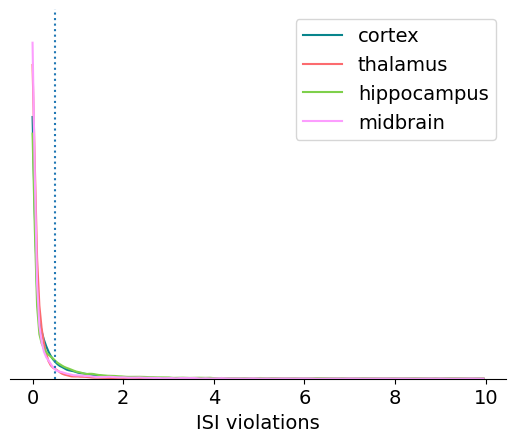

In [ ]:
bins = np.linspace(0,10,200)
max_value = -np.inf

for idx, region in enumerate(region_dict.keys()):

    data = units[units.ecephys_structure_acronym.isin(region_dict[region])]['isi_violations']

    max_value = plot_metric(data, bins, 'ISI violations', color_dict[region], max_value)

_ = plt.legend(region_dict.keys())

plt.plot([0.5, 0.5],[0,max_value], ':')

This one looks like a good candidate for plotting on a log scale:

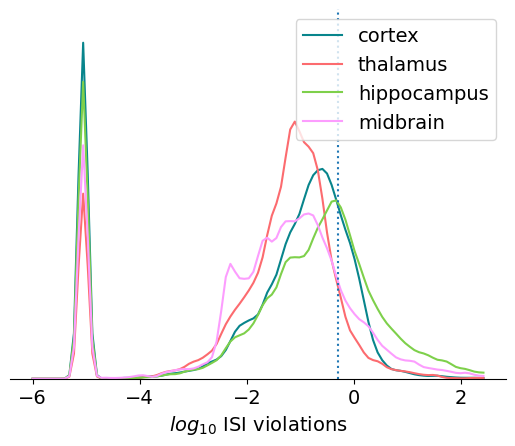

In [ ]:
bins = np.linspace(-6,2.5,100)
max_value = -np.inf

for idx, region in enumerate(region_dict.keys()):

    data = np.log10(units[units.ecephys_structure_acronym.isin(region_dict[region])]['isi_violations'] + 1e-5)

    max_value = plot_metric(data, bins, '$log_{10}$ ISI violations', color_dict[region], max_value)

_ = plt.legend(region_dict.keys())

plt.plot([np.log10(0.5), np.log10(0.5)],[0,max_value], ':')

A few things to note about this plot:

* We've added 0.00001 to the ISI violations values, because the log of 0 is undefined. This creates a peak at -5 for all the units with no ISI violations
* The hippocampus has the most units with high ISI violations, likely due to the density of cells in this structure.
* The default threshold of 0.5 is still quite permissive

If we wanted to only include units with no ISI violations, what percentage would be available for analysis?

In [ ]:
np.around(np.sum(units.isi_violations == 0.0) / len(units), 2)

0.14

Here's a summary of things to keep in mind when using `isi_violations` in your analysis:

**How it can be biased**
* As with all metrics, ISI violations may not be stable throughout the experiment. It may be helpful to re-calculate it for the specific epochs you're analyzing.
* Two neurons with similar waveforms, but firing in largely non-overlapping epochs, could end up being merged into the same cluster. In this case, the ISI violations may be low, even though the resulting unit is a highly contaminated. This situation would tricky to catch, but fortunately shouldn't happen very often.

**How it should be used**
* Setting your ISI violations threshold to 0 (or close to it), will help ensure that contaminated units don't make it into your analysis, but will greatly reduce the number of units available. You should think carefully about what degree of contamination your analysis can tolerate without biasing your conclusions. For example, if you are comparing firing rates of individual units across areas, you'll want to set a low ISI violations threshold to prevent contaminating spikes from affecting your estimates. On the other hand, if you're comparing overall firing rates between areas, counting spikes from contaminated clusters may be valid.

### SNR

Signal-to-noise ratio, or SNR, is another classic metric of unit quality. It measures the ratio of the maximum amplitude of the mean spike waveform to the standard deviation of the background noise on one channel. Even though it's widely used in the literature, we don't recommend using it on Neuropixels data for two reasons:

1. It only takes into account the unit's peak channel, despite the fact that waveforms are often spread across a dozen channels or more.
2. If the waveform changes due to drift, peak channel SNR can change dramatically, even though overall isolation quality remains consistent.

Nevertheless, it can still be helpful to look at the distribution of SNRs across areas:

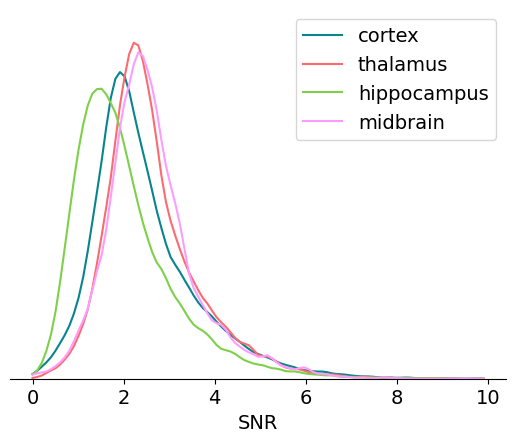

In [ ]:
bins = np.linspace(0,10,100)
max_value = -np.inf

for idx, region in enumerate(region_dict.keys()):

    data = units[units.ecephys_structure_acronym.isin(region_dict[region])]['snr']

    max_value = plot_metric(data, bins, 'SNR', color_dict[region], max_value)

_ = plt.legend(region_dict.keys())

We can clearly see an increase in overall SNR from hippocampus to cortex to thalamus and midbrain. These changes likely result from differences in the size, density, and orientation of cell bodies in these regions. A more explicit comparison between extracellular ephys signal quality and histological features would be an interesting research topic.

Here's a summary of things to keep in mind when using `snr` in your analysis:

**How it can be biased**
* SNR only considers information contained in a single channel, and therefore cannot capture isolation quality accurately
* If the peak channel moves across the probe due to electrode drift, SNR will drop.

**How it should be used**
* SNR can be helpful as a point of comparison to the previous literature
* It should not be used to filter data in isolation

That said, a modified version of the SNR metric that is tolerant to electrode drift could be highly informative. Future Allen Institute data releases may include such a metric.

### Isolation distance

Isolation distance is a metric based on the principal components (PCs) of a unit's waveforms. After the spike sorting step is complete, the waveforms for every spike are projected into a lower-dimensional principal component space. By default, Kilosort2 saves the top 3 PCs for 32 channels around each unit's peak channel—this is a huge amount of data, but it's greatly compressed compared to the original 60 samples x 350+ channels for each waveform. PC-based metrics are a useful way of validating cluster quality because, at least for Kilosort2, the original sorting process doesn't rely on the waveform's principal components.

You can imagine each unit's PCs a clusters in a 32 x 3 = 96-dimensional space. Isolation distance calculates the size of the 96-dimensional sphere that includes as many "other" spikes as are contained in the original unit's cluster, after normalizing the clusters by their standard deviation in each dimension (Mahalanobis distance). The higher the isolation distance, the more a unit is separated from its neighbors in PC space, and therefore the lower the likelihood that it's contamined by spikes from multiple units.

Let's look at the range of isolation distances across different brain regions:

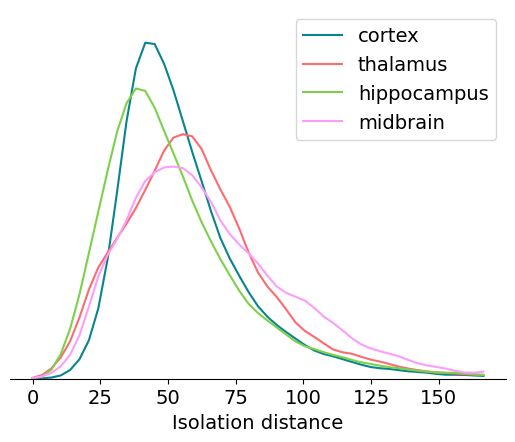

In [ ]:
bins = np.linspace(0,170,50)
max_value = -np.inf

for idx, region in enumerate(region_dict.keys()):

    data = units[units.ecephys_structure_acronym.isin(region_dict[region])]['isolation_distance']

    max_value = plot_metric(data, bins, 'Isolation distance', color_dict[region], max_value)

_ = plt.legend(region_dict.keys())

Here's a summary of things to keep in mind when using `isolation_distance` in your analysis:

**How it can be biased**
* Isolation distance is not immune to drift; if a unit's waveform changes as a result of electrode motion, it could reduce isolation distance without necessarily causing the unit to become more contaminated.
* The exact value of isolation distance will depend on the number of PCs used in the calculation; therefore, it's difficult to compare this metric to previous reports in the literature.

**How it should be used**
* Isolation distance is correlated with overall cluster quality, but it's not a direct measure of contamination rate. For this reason, it should be used in conjunction with other metrics, such as `isi_violations`, that more directly measure the likelihood of contaminating spikes.

### d-prime

Like isolation distance, d-prime is another metric calculated for the waveform PCs. It uses linear discriminant analysis to calculate the separability of one unit's PC cluster and all of the others. A higher d-prime value indicates that the unit is better isolated from its neighbors.

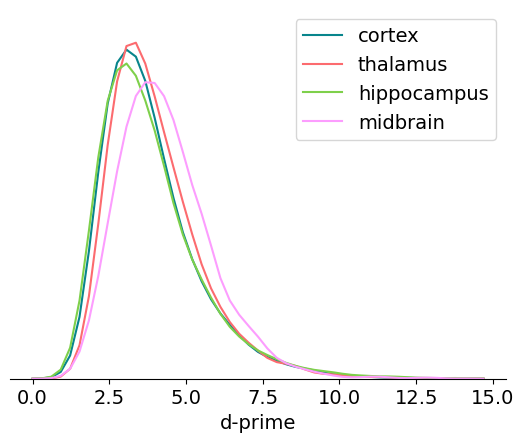

In [ ]:
bins = np.linspace(0,15,50)
max_value = -np.inf

for idx, region in enumerate(region_dict.keys()):

    data = units[units.ecephys_structure_acronym.isin(region_dict[region])]['d_prime']

    max_value = plot_metric(data, bins, 'd-prime', color_dict[region], max_value)

_ = plt.legend(region_dict.keys())

Here's a summary of things to keep in mind when using `d_prime` in your analysis:

**How it can be biased**
* Like isolation distance, d-prime is not tolerant to drift. Since a single value of d-prime is computed for the entire session, the d-prime value is actually a lower bound on the true value of this metric computed at any one timepoint.

**How it should be used**
* d-prime, in principal, gives you an estimate of the false positive rate for each unit. However, more work is required to validate this.

### Nearest-neighbors hit rate

Nearest-neighbors hit rate is another PC-based quality metric. It's derived from the 'isolation' metric originally reported in [Chung, Magland et al. (2017)](https://www.sciencedirect.com/science/article/pii/S0896627317307456?via%3Dihub). This metric looks at the PCs for one unit and calculates the fraction of their nearest neighbors that fall within the same cluster. If a unit is highly contaminated, then many of the closest spikes will come from other units. Nearest-neighbors hit rate is nice because it always falls between 0 and 1, making it straightforward to compare across different datasets.

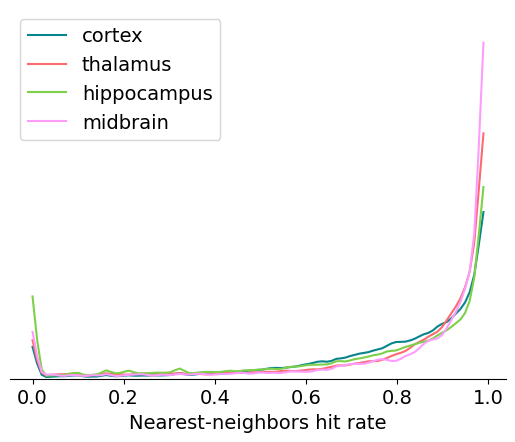

In [ ]:
bins = np.linspace(0,1,100)
max_value = -np.inf

for idx, region in enumerate(region_dict.keys()):

    data = units[units.ecephys_structure_acronym.isin(region_dict[region])]['nn_hit_rate']

    max_value = plot_metric(data, bins, 'Nearest-neighbors hit rate', color_dict[region], max_value)

_ = plt.legend(region_dict.keys())

Here's a summary of things to keep in mind when using `nn_hit_rate` in your analysis:

**How it can be biased**
* Like the other PC-based metrics, `nn_hit_rate` can be negatively impacted by electrode drift.

**How it should be used**
* `nn_hit_rate` is a nice proxy for overall cluster quality, but should be used in conjunction with other metrics that measure missing spikes or contamination rate more directly.

### Summary

To summarize, let's take a look at the range of values that each of these metrics takes across the whole dataset:

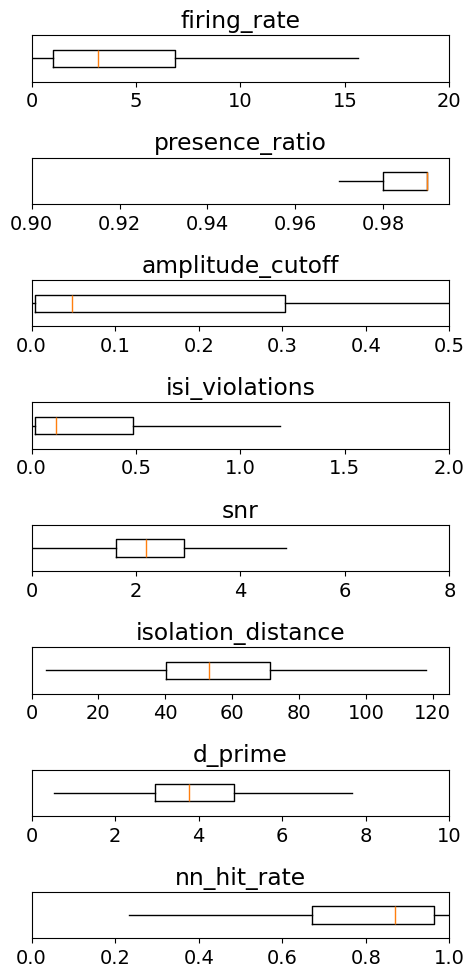

In [ ]:
metrics = ['firing_rate',
           'presence_ratio',
           'amplitude_cutoff',
           'isi_violations',
           'snr',
           'isolation_distance',
           'd_prime',
           'nn_hit_rate']

ranges = [[0,20],
          [0.9,0.995],
          [0,0.5],
          [0,2],
          [0,8],
          [0,125],
          [0,10],
          [0,1]]

_ = plt.figure(figsize=(5,10))

for idx, metric in enumerate(metrics):

    data = units[metric].values
    data = data[np.invert(np.isnan(data))]

    _ = plt.subplot(len(metrics),1,idx+1)
    _ = plt.boxplot(data, showfliers=False, showcaps=False, vert=False)
    _ = plt.ylim([0.8,1.2])
    _ = plt.xlim(ranges[idx])
    _ = plt.yticks([])

    plt.title(metric)

plt.tight_layout()

# Analyzing Receptive Fields

One of the most important features of visually responsive neurons is the location and extent of their receptive field. Is it highly localized or spatially distributed? Is it centered on the stimulus display, or is it on an edge? How much does it overlap with the receptive fields of neurons in other regions? Obtaining answers to these questions is a crucial step for interpreting a results related to neurons' visual coding properties.

In [ ]:
rf_stim_table = session.stimulus_presentations[session.stimulus_presentations.stimulus_name == 'gabors']
len(rf_stim_table)

3645

There are 3645 trials for the receptive field mapping stimulus. What combination of stimulus parameters is used across these trials? Let's see which parameters actually vary for this stimulus:

In [ ]:
keys = rf_stim_table.keys()
[key for key in keys if len(np.unique(rf_stim_table[key])) > 1]

['start_time',
 'stop_time',
 'orientation',
 'x_position',
 'y_position',
 'duration',
 'stimulus_condition_id']

We can ignore the parameters related to stimulus timing (`start_time`, `stop_time`, and `duration`), as well as `stimulus_condition_id`, which is used to find presentations with the same parameters. So we're left with `orientation`, `x_position`, and `y_position`.

In [ ]:
print('Unique orientations : ' + str(list(np.sort(rf_stim_table.orientation.unique()))))
print('Unique x positions : ' + str(list(np.sort(rf_stim_table.x_position.unique()))))
print('Unique y positions : ' + str(list(np.sort(rf_stim_table.y_position.unique()))))

Unique orientations : [0.0, 45.0, 90.0]
Unique x positions : [-40.0, -30.0, -20.0, -10.0, 0.0, 10.0, 20.0, 30.0, 40.0]
Unique y positions : [-40.0, -30.0, -20.0, -10.0, 0.0, 10.0, 20.0, 30.0, 40.0]


We have 3 orientations and a 9 x 9 grid of spatial locations. Note that these locations are relative to the center of the screen, not the mouse's center of gaze. How many repeats are there for each condition?

In [ ]:
len(rf_stim_table) / (3 * 9 * 9)

15.0

This should match the number we get when dividing the length of the DataFrame by the total number of conditions:

In [ ]:
len(rf_stim_table) / len(np.unique(rf_stim_table.stimulus_condition_id))

15.0

What about the drifting grating parameters that don't vary, such as size (in degrees), spatial frequency (in cycles/degree), temporal frequency (in Hz), and contrast?

In [ ]:
print('Spatial frequency: ' + str(rf_stim_table.spatial_frequency.unique()[0]))
print('Temporal frequency: ' + str(rf_stim_table.temporal_frequency.unique()[0]))
print('Size: ' + str(rf_stim_table['size'].unique()[0]))
print('Contrast: ' + str(rf_stim_table['contrast'].unique()[0]))

Spatial frequency: 0.08
Temporal frequency: 4.0
Size: [20.0, 20.0]
Contrast: 0.8


This stimulus is designed to drive neurons reliably across a wide variety of visual areas. Because of the large size (20 degree diameter), it lacks spatial precision. It also cannot be used to map on/off subfields on neurons. However, this is a reasonable compromise to allow us to map receptive fields with high reliability across all visual areas we're recording from.

Now that we have a better understanding of the stimulus, let's look at receptive fields for some neurons.

In [ ]:
rf_stim_table.keys()

Index(['stimulus_block', 'start_time', 'stop_time', 'size', 'contrast',
       'spatial_frequency', 'orientation', 'x_position', 'frame', 'color',
       'y_position', 'stimulus_name', 'temporal_frequency', 'phase',
       'duration', 'stimulus_condition_id'],
      dtype='object')

### Plotting receptive fields

In order to visualize receptive fields, we're going to use a function in the `ReceptiveFieldMapping` class, one of the stimulus-specific analysis classes in the AllenSDK. Let's import it and create a `rf_mapping` object based on the `session` we loaded earlier:

In [ ]:
rf_mapping = ReceptiveFieldMapping(session)

The `rf_mapping` object contains a variety of methods related to receptive field mapping. Its `stim_table` property holds the same DataFrame we created earlier.

In [ ]:
rf_mapping.stim_table.head()

,stimulus_block,start_time,stop_time,size,contrast,spatial_frequency,orientation,x_position,y_position,stimulus_name,temporal_frequency,phase,duration,stimulus_condition_id
stimulus_presentation_id,,,,,,,,,,,,,,
1,0.0,73.537433,73.770952,"[20.0, 20.0]",0.8,0.08,45.0,0.0,30.0,gabors,4.0,"[3644.93333333, 3644.93333333]",0.233519,1
2,0.0,73.770952,74.021150,"[20.0, 20.0]",0.8,0.08,0.0,-30.0,-10.0,gabors,4.0,"[3644.93333333, 3644.93333333]",0.250199,2
3,0.0,74.021150,74.271349,"[20.0, 20.0]",0.8,0.08,45.0,10.0,20.0,gabors,4.0,"[3644.93333333, 3644.93333333]",0.250199,3
4,0.0,74.271349,74.521547,"[20.0, 20.0]",0.8,0.08,0.0,-40.0,-40.0,gabors,4.0,"[3644.93333333, 3644.93333333]",0.250199,4
5,0.0,74.521547,74.771764,"[20.0, 20.0]",0.8,0.08,90.0,-10.0,-10.0,gabors,4.0,"[3644.93333333, 3644.93333333]",0.250216,5


In [ ]:
rf_mapping.stim_table.shape

(3645, 14)

Before we calculate any receptive fields, let's find some units in primary visual cortex (VISp) that are likely to show clear receptive fields:

In [ ]:
v1_units = session.units[session.units.ecephys_structure_acronym == 'VISp']

Now, calculating the receptive field is as simple as calling `get_receptive_field()` with a unit ID as the input argument.

In [ ]:
RF = rf_mapping.get_receptive_field(v1_units.index.values[3])

/usr/local/lib/python3.11/dist-packages/allensdk/brain_observatory/ecephys/ecephys_session.py:764: UserWarning: You've specified some overlapping time intervals between neighboring rows: [(0, 1)], with a maximum overlap of 0.01548129072689619 seconds.
  warnings.warn("You've specified some overlapping time intervals "


This method creates a 2D histogram of spike counts at all 81 possible stimulus locations, and outputs it as a 9 x 9 matrix. It's summing over all orientations, so each pixel contains the spike count across 45 trials.

To plot it, just display it as an image. The matrix is already in the correct orientation so that it matches the layout of the screen (e.g., the upper right pixel contains the spike count when the Gabor patch was in the upper right of the screen).

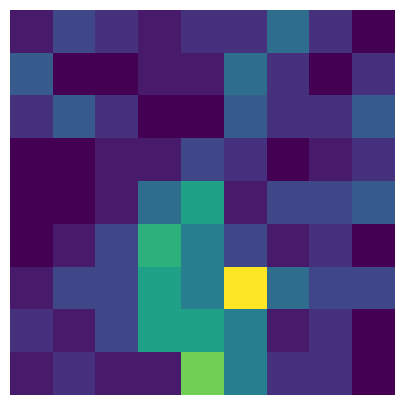

In [ ]:
plt.figure(figsize=(5,5))
_ = plt.imshow(RF)
_ = plt.axis('off')

This particular unit has a receptive field that's more or less in the center of the screen.

Let's plot the receptive fields for all the units in V1:

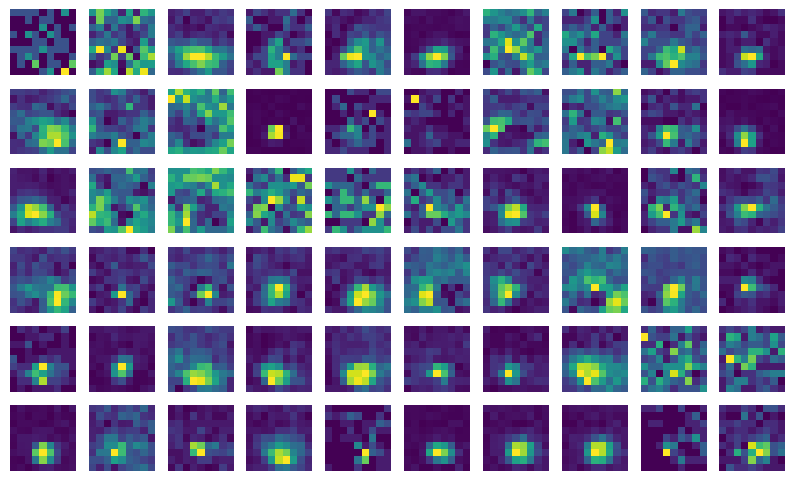

In [ ]:
def plot_rf(unit_id, index):
    RF = rf_mapping.get_receptive_field(unit_id)
    _ = plt.subplot(6,10,index+1)
    _ = plt.imshow(RF)
    _ = plt.axis('off')

_ = plt.figure(figsize=(10,6))
_ = [plot_rf(RF, index) for index, RF in enumerate(v1_units.index.values)]

# Optotagging

This section explains how to analyze responses to optotagging stimuli in Neuropixels Brain Observatory datasets. Optotagging makes it possible to link _in vivo_ spike trains to genetically defined cell classes. By expressing a light-gated ion channel (in this case, ChR2) in a Cre-dependent manner, we can activate Cre+ neurons with light pulses delivered to the cortical surface. Units that fire action potentials in response to these light pulses are likely to express the gene of interest.

Of course, there are some shortcomings to this approach, most notably that the presence of light artifacts can create the appearance of false positives, and that false negatives (cells that are Cre+ but do not respond to light) are nearly impossible to avoid. I will explain how to deal with these caveats in order to incorporate the available cell type information into your analyses.

The `sessions` table contains information about all the experiments available in the `EcephysProjectCache`. The `full_genotype` column contains information about the genotype of the mouse used in each experiment.

In [ ]:
sessions = cache.get_session_table()
sessions.full_genotype.value_counts()

,full_genotype
wt/wt,30
Sst-IRES-Cre/wt;Ai32(RCL-ChR2(H134R)_EYFP)/wt,12
Pvalb-IRES-Cre/wt;Ai32(RCL-ChR2(H134R)_EYFP)/wt,8
Vip-IRES-Cre/wt;Ai32(RCL-ChR2(H134R)_EYFP)/wt,8


About half the mice are wild type (`wt/wt`), while the other half are a cross between a Cre line and the Ai32 reporter line. The Cre mice express ChR2 in one of three interneuron subtypes: Parvalbumin-positive neurons (`Pvalb`), Somatostatin-positive neurons (`Sst`), and Vasoactive Intestinal Polypeptide neurons (`Vip`). We know that these genes are expressed in largely non-overlapping populations of inhibitory cells, and that, taken together, they [cover nearly the entire range of cortical GABAergic neurons](https://www.ncbi.nlm.nih.gov/pmc/articles/PMC3556905/#!po=8.92857), with the caveat that VIP+ cells are a subset of a larger group of 5HT3aR-expressing cells.

To find experiments performed on a specific genotype, we can filter the sessions table on the `full_genotype` column:

In [ ]:
pvalb_sessions = sessions[sessions.full_genotype.str.match('Pvalb')]
pvalb_sessions

,published_at,specimen_id,session_type,age_in_days,sex,full_genotype,unit_count,channel_count,probe_count,ecephys_structure_acronyms
id,,,,,,,,,,
721123822,2019-10-03T00:00:00Z,707296982,brain_observatory_1.1,125.0,M,Pvalb-IRES-Cre/wt;Ai32(RCL-ChR2(H134R)_EYFP)/wt,444,2229,6,"[MB, SCig, PPT, NOT, DG, CA1, VISam, nan, LP, ..."
746083955,2019-10-03T00:00:00Z,726170935,brain_observatory_1.1,98.0,F,Pvalb-IRES-Cre/wt;Ai32(RCL-ChR2(H134R)_EYFP)/wt,582,2216,6,"[VPM, TH, LGd, CA3, CA2, CA1, VISal, nan, grey..."
760345702,2019-10-03T00:00:00Z,739783171,brain_observatory_1.1,103.0,M,Pvalb-IRES-Cre/wt;Ai32(RCL-ChR2(H134R)_EYFP)/wt,501,1862,5,"[MB, TH, PP, PIL, DG, CA3, CA1, VISal, nan, gr..."
773418906,2019-10-03T00:00:00Z,757329624,brain_observatory_1.1,124.0,F,Pvalb-IRES-Cre/wt;Ai32(RCL-ChR2(H134R)_EYFP)/wt,546,2232,6,"[PPT, NOT, SUB, ProS, CA1, VISam, nan, APN, DG..."
797828357,2019-10-03T00:00:00Z,776061251,brain_observatory_1.1,107.0,M,Pvalb-IRES-Cre/wt;Ai32(RCL-ChR2(H134R)_EYFP)/wt,611,2232,6,"[PPT, MB, APN, NOT, HPF, ProS, CA1, VISam, nan..."
829720705,2019-10-03T00:00:00Z,811322619,functional_connectivity,112.0,M,Pvalb-IRES-Cre/wt;Ai32(RCL-ChR2(H134R)_EYFP)/wt,529,1841,5,"[SCig, SCop, SCsg, SCzo, POST, VISp, nan, CA1,..."
839557629,2019-10-03T00:00:00Z,821469666,functional_connectivity,115.0,M,Pvalb-IRES-Cre/wt;Ai32(RCL-ChR2(H134R)_EYFP)/wt,450,1853,5,"[APN, NOT, MB, DG, CA1, VISam, nan, VISpm, LGd..."
840012044,2019-10-03T00:00:00Z,820866121,functional_connectivity,116.0,M,Pvalb-IRES-Cre/wt;Ai32(RCL-ChR2(H134R)_EYFP)/wt,758,2298,6,"[APN, DG, CA1, VISam, nan, LP, VISpm, VISp, LG..."


The table above contains 8 sessions, 5 of which used the `brain_observatory_1.1` visual stimulus, and 3 of which used the `functional_connectivity` stimulus. Any experiments with the same stimulus set are identical across genotypes. Importantly, the optotagging stimulus does not occur until the end of the experiment, so any changes induced by activating a specific set of interneurons will not affect the visual responses that we measure.

### Types of optotagging stimuli

Let's load one of the above sessions to see how to extract information about the optotagging stimuli that were delivered.

In [ ]:
pvalb_sessions.index.values[-3]

829720705

In [ ]:
# del session
# gc.collect()
session = cache.get_session_data(pvalb_sessions.index.values[-3])

/usr/local/lib/python3.11/dist-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'hdmf-common' version 1.1.3 because version 1.8.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/usr/local/lib/python3.11/dist-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.2.2 because version 2.7.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."


The optotagging stimulus table is stored separately from the visual stimulus table. So instead of calling `session.stimulus_presentations`, we will use `session.optogenetic_stimulation_epochs` to load a DataFrame that contains the information about the optotagging stimuli:

In [ ]:
session.optogenetic_stimulation_epochs

,start_time,condition,level,stop_time,stimulus_name,duration
id,,,,,,
0,9208.46044,a single square pulse,2.0,9208.46544,pulse,0.005
1,9210.64062,a single square pulse,1.7,9210.65062,pulse,0.010
2,9212.37064,2.5 ms pulses at 10 Hz,1.7,9213.37064,fast_pulses,1.000
3,9214.40076,2.5 ms pulses at 10 Hz,1.3,9215.40076,fast_pulses,1.000
4,9216.55091,2.5 ms pulses at 10 Hz,2.0,9217.55091,fast_pulses,1.000
...,...,...,...,...,...,...
295,9778.77516,2.5 ms pulses at 10 Hz,2.0,9779.77516,fast_pulses,1.000
296,9780.72530,half-period of a cosine wave,2.0,9781.72530,raised_cosine,1.000
297,9782.66528,a single square pulse,1.3,9782.67028,pulse,0.005


This returns a table with information about each optotagging trial. To find the unique conditions across all trials, we can use the following Pandas syntax:

In [ ]:
columns = ['stimulus_name', 'duration','level']
session.optogenetic_stimulation_epochs.drop_duplicates(columns).sort_values(by=columns).drop(columns=['start_time','stop_time'])

,condition,level,stimulus_name,duration
id,,,,
3,2.5 ms pulses at 10 Hz,1.3,fast_pulses,1.000
2,2.5 ms pulses at 10 Hz,1.7,fast_pulses,1.000
4,2.5 ms pulses at 10 Hz,2.0,fast_pulses,1.000
17,a single square pulse,1.3,pulse,0.005
7,a single square pulse,1.7,pulse,0.005
0,a single square pulse,2.0,pulse,0.005
13,a single square pulse,1.3,pulse,0.010
1,a single square pulse,1.7,pulse,0.010
8,a single square pulse,2.0,pulse,0.010


The optotagging portion of the experiment includes four categories of blue light stimuli: 2.5 ms pulses delivered at 10 Hz for one second, a single 5 ms pulse, a single 10 ms pulse, and a raised cosine pulse lasting 1 second. All of these stimuli are delivered through a 400 micron-diameter fiber optic cable positioned to illuminate the surface of visual cortex. Each stimulus is delivered at one of three power levels, defined by the peak voltage of the control signal delivered to the light source, not the actual light power at the tip of the fiber.

Unfortunately, light power has not been perfectly matched across experiments. A little more than halfway through the data collection process, we switched from delivering light through an LED (maximum power at fiber tip = 4 mW) to a laser (maximum power at fiber tip = 35 mW), in order to evoke more robust optotagging responses. To check whether or not a particular experiment used a laser, you can use the following filter:

In [ ]:
sessions.index.values >= 789848216

array([False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True])

The authors realized that this makes it more difficult to compare results across experiments, but they decided it was better to improve the optotagging yield for later sessions than continue to use light levels that were not reliably driving spiking responses.

### Aligning spikes to light pulses

Aligning spikes to light pulses is a bit more involved than aligning spikes to visual stimuli. This is because we haven't yet created convenience functions for performing this alignment automatically, such as `session.presentationwise_spike_times` or `sesssion.presentationwise_spike_counts`. We are planning to incorporate such functions into the AllenSDK in the future, but for now, you'll have to write your own code for extracting spikes around light pulses (or copy the code below).

Let's choose a stimulus condition (10 ms pulses) and a set of units (visual cortex only), then create a DataArray containing binned spikes aligned to the start of each stimulus.

In [ ]:
trials = session.optogenetic_stimulation_epochs[(session.optogenetic_stimulation_epochs.duration > 0.009) & \
                                                (session.optogenetic_stimulation_epochs.duration < 0.02)]

units = session.units[session.units.ecephys_structure_acronym.str.match('VIS')]

time_resolution = 0.0005 # 0.5 ms bins

bin_edges = np.arange(-0.01, 0.025, time_resolution)

def optotagging_spike_counts(bin_edges, trials, units):

    time_resolution = np.mean(np.diff(bin_edges))

    spike_matrix = np.zeros( (len(trials), len(bin_edges), len(units)) )

    for unit_idx, unit_id in enumerate(units.index.values):

        spike_times = session.spike_times[unit_id]

        for trial_idx, trial_start in enumerate(trials.start_time.values):

            in_range = (spike_times > (trial_start + bin_edges[0])) * \
                       (spike_times < (trial_start + bin_edges[-1]))

            binned_times = ((spike_times[in_range] - (trial_start + bin_edges[0])) / time_resolution).astype('int')
            spike_matrix[trial_idx, binned_times, unit_idx] = 1

    return xr.DataArray(
        name='spike_counts',
        data=spike_matrix,
        coords={
            'trial_id': trials.index.values,
            'time_relative_to_stimulus_onset': bin_edges,
            'unit_id': units.index.values
        },
        dims=['trial_id', 'time_relative_to_stimulus_onset', 'unit_id']
    )

da = optotagging_spike_counts(bin_edges, trials, units)

We can use this DataArray to plot the average firing rate for each unit as a function of time:

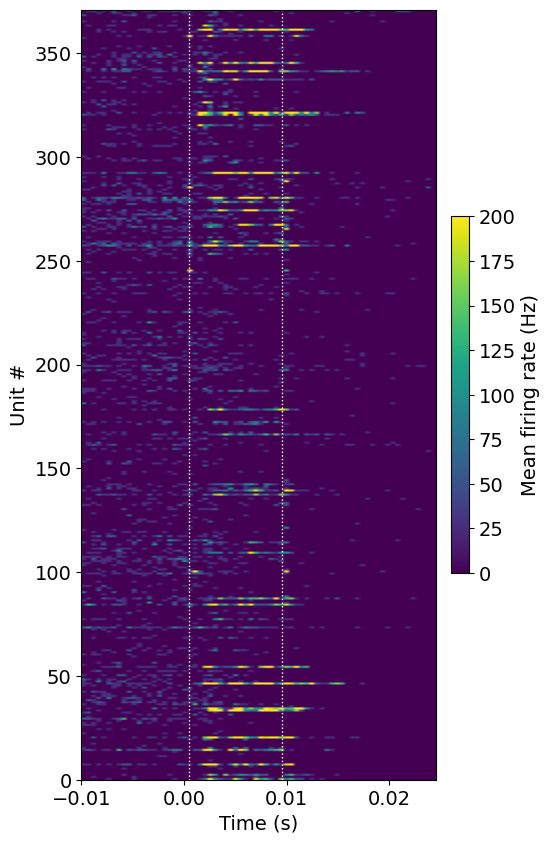

In [ ]:
def plot_optotagging_response(da):

    plt.figure(figsize=(5,10))

    plt.imshow(da.mean(dim='trial_id').T / time_resolution,
               extent=[np.min(bin_edges), np.max(bin_edges),
                       0, len(units)],
               aspect='auto', vmin=0, vmax=200)

    for bound in [0.0005, 0.0095]:
        plt.plot([bound, bound],[0, len(units)], ':', color='white', linewidth=1.0)

    plt.xlabel('Time (s)')
    plt.ylabel('Unit #')

    cb = plt.colorbar(fraction=0.046, pad=0.04)
    cb.set_label('Mean firing rate (Hz)')

plot_optotagging_response(da)

In this plot, we can see that a number of units increase their firing rate during the stimulus window, firing a burst of around three spikes. This is typical for Parvalbumin-positive neurons, which fire at high rates under natural conditions.

However, there are also some units that seem to fire at the very beginning and/or very end of the light pulse. These spikes are almost certainly artifactual, as it takes at least 1 ms to generate a true light-evoked action potential. Therefore, we need to disregard these low-latency "spikes" in our analysis.

### Identifying `Cre+` units

Now that we know how to align spikes, we can start assessing which units are reliably driven by the optotagging stimulus and are likely to be Cre+.

There are a variety of ways to do this, but these are the most important things to keep in mind:
* Spikes that occur precisely at the start or end of a light pulse are likely artifactual, and need to be ignored.
* The bright blue light required for optotagging _can_ be seen by the mouse, so any spikes that occur more than 40 ms after the stimulus onset may result from retinal input, as opposed to direct optogenetic drive.
* The rate of false negatives (Cre+ cells that are not light-driven) will vary across areas, across depths, and across sessions. We've tried our best to evenly illuminate the entire visual cortex, and to use light powers that can drive spikes throughout all cortical layers, but some variation is inevitable.

For these reasons, we've found that the 10 ms pulses are the most useful stimulus for finding true light-evoked activity. These pulses provide a long enough artifact-free window to observe light-evoked spikes, but do not last long enough to be contaminated by visually driven activity.

Using the DataArray we created previously, we can search for units that increase their firing rate during the 10 ms pulse:

In [ ]:
baseline = da.sel(time_relative_to_stimulus_onset=slice(-0.01,-0.002))
baseline_rate = baseline.sum(dim='time_relative_to_stimulus_onset').mean(dim='trial_id') / 0.008

evoked = da.sel(time_relative_to_stimulus_onset=slice(0.001,0.009))
evoked_rate = evoked.sum(dim='time_relative_to_stimulus_onset').mean(dim='trial_id') / 0.008

Comparing the baseline and evoked rates, we can see a clear subset of units with a light-evoked increase in firing rate:

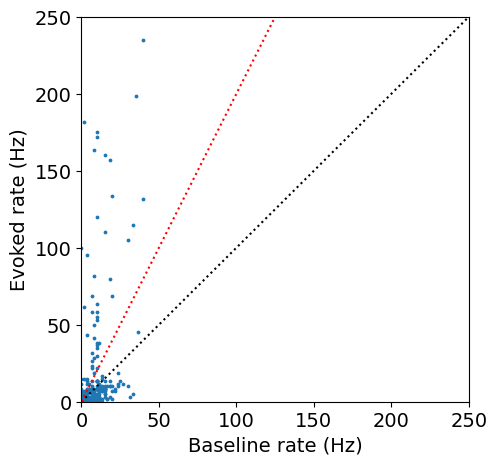

In [ ]:
plt.figure(figsize=(5,5))

plt.scatter(baseline_rate, evoked_rate, s=3)

axis_limit = 250
plt.plot([0,axis_limit],[0,axis_limit], ':k')
plt.plot([0,axis_limit],[0,axis_limit*2], ':r')
plt.xlim([0,axis_limit])
plt.ylim([0,axis_limit])

plt.xlabel('Baseline rate (Hz)')
_ = plt.ylabel('Evoked rate (Hz)')

We can select a threshold, such as 2x increase in firing rate (red line) to find the IDs for units that are robustly driven by the light:

In [ ]:
cre_pos_units = da.unit_id[(evoked_rate / (baseline_rate + 1)) > 2].values # add 1 to prevent divide-by-zero errors
cre_pos_units

array([951131472, 951131470, 951131486, 951131478, 951131522, 951131506,
       951131782, 951131534, 951131558, 951131556, 951131564, 951131560,
       951131581, 951131589, 951131583, 951131593, 951131612, 951131643,
       951131689, 951132054, 951132138, 951132140, 951132159, 951132184,
       951132212, 951132205, 951132224, 951132236, 951133681, 951133822,
       951133909, 951134030, 951134026, 951134066, 951134100, 951134199,
       951136071, 951136175, 951136247, 951136394, 951136657, 951136717,
       951136829, 951137028, 951137073, 951137204, 951140485, 951140617,
       951141942, 951140861, 951140832, 951140821, 951141065, 951141978,
       951141097, 951141154, 951141292, 951141373, 951141485, 951141536])

Because this is a Parvalbumin-Cre mouse, we expect the majority of light-driven units to be fast-spiking interneurons. We can check this by plotting the mean waveforms for the units we've identified.

/usr/local/lib/python3.11/dist-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'hdmf-common' version 1.1.3 because version 1.8.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/usr/local/lib/python3.11/dist-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.2.2 because version 2.7.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."


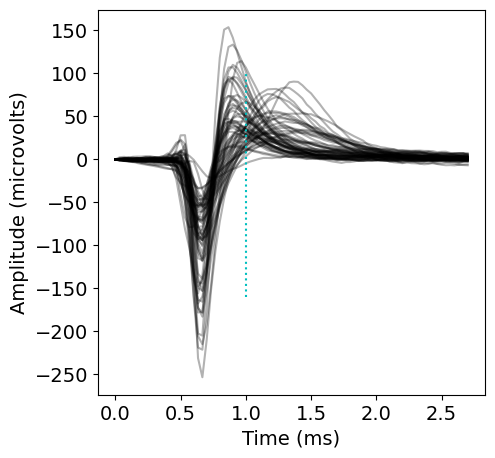

In [ ]:
plt.figure(figsize=(5,5))

for unit_id in cre_pos_units:

    peak_channel = session.units.loc[unit_id].peak_channel_id
    wv = session.mean_waveforms[unit_id].sel(channel_id = peak_channel)

    plt.plot(wv.time * 1000, wv, 'k', alpha=0.3)

plt.xlabel('Time (ms)')
plt.ylabel('Amplitude (microvolts)')
_ =plt.plot([1.0, 1.0],[-160, 100],':c')

Indeed, most of these units have stereotypical "fast-spiking" waveforms (with a peak earlier than 1 ms). The outliers are likely parvalbumin-positive pyramidal cells.

### Differences across genotypes

The example above is a "best-case" scenario. As you look across experiments, you will find that there is substantial variability in the fraction of light-driven neurons. Some of this can be accounted for by differences in light power. But much of the variability can be attributed to genotype: parvalbumin+ cells are the most abundant type of inhibitory cells in the cortex, with somastatin+ cells coming next, and VIP+ cells a distant third. There are also likely differences in our ability to record from different interneuron subtypes. For example, parvalbumin+ cells generally fire at the highest rates, which makes them easier to detect in extracellular electrophysiology experiments. The size of the cell's soma also plays a role in its recordability, and this likely varies across interneuron sub-classes.

Overall, it is clear that VIP+ cells have proven the most difficult to identify through optotagging methods. The VIP-Cre mice we've recorded contain _very_ few light-driven units: the number is on the order of one per probe, and is sometimes zero across the whole experiment. We're not yet sure whether this is due to the difficultly of recording VIP+ cells with Neuropixels probes, or the difficulty of driving them with ChR2. To confounding things even further, VIP+ cells tend to have a _disinhibitory_ effect on the local circuit, so units that significantly increase their firing during the 1 s raised cosine light stimulus are not guaranteed to be Cre+.

In any case, it will be helpful to look at some characteristic examples of light-evoked responses in Sst-Cre and Vip-Cre mice, so you know what to expect.

In [ ]:
sessions[sessions.full_genotype.str.match('Sst')].index.values

array([715093703, 719161530, 756029989, 758798717, 760693773, 762602078,
       786091066, 787025148, 789848216, 794812542, 831882777, 839068429])

In [ ]:
sst_sessions = sessions[sessions.full_genotype.str.match('Sst')]
session = cache.get_session_data(sst_sessions.index.values[-1])

/usr/local/lib/python3.11/dist-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'hdmf-common' version 1.1.3 because version 1.8.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/usr/local/lib/python3.11/dist-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.2.2 because version 2.7.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."


In [ ]:
trials = session.optogenetic_stimulation_epochs[(session.optogenetic_stimulation_epochs.duration > 0.009) & \
                                                (session.optogenetic_stimulation_epochs.duration < 0.02)]

units = session.units[session.units.ecephys_structure_acronym.str.match('VIS')]

bin_edges = np.arange(-0.01, 0.025, 0.0005)

da = optotagging_spike_counts(bin_edges, trials, units)

/usr/local/lib/python3.11/dist-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'hdmf-common' version 1.1.3 because version 1.8.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/usr/local/lib/python3.11/dist-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.2.2 because version 2.7.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/usr/local/lib/python3.11/dist-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'hdmf-common' version 1.1.3 because version 1.8.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/usr/local/lib/python3.11/dist-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.2.2 because version 2.7.0 is already loaded.
  warn("Ignoring cached namespace '%s' vers

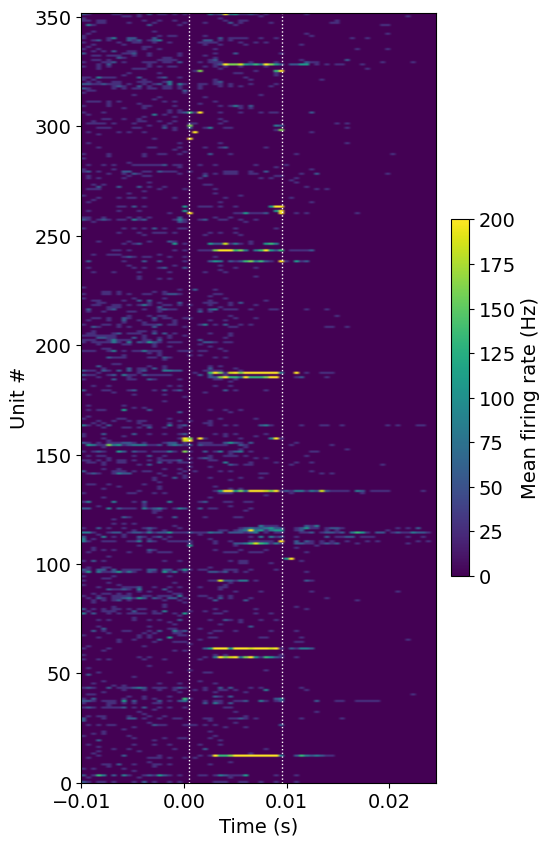

In [ ]:
plot_optotagging_response(da)

In this Sst-Cre mouse, we see a smaller fraction of light-driven units than in the Pvalb-Cre mouse. The light-driven units tend to spike at a range of latencies following light onset, rather than displaying the rhythmic firing pattern of Parvalbumin+ cells. Again, note that the spikes that are precisely aligned to the light onset or offset are likely artifactual.

Now that we've computed the average responses, we can use the same method as above to find the units that are activated by the light.

In [ ]:
baseline = da.sel(time_relative_to_stimulus_onset=slice(-0.01,-0.002))
baseline_rate = baseline.sum(dim='time_relative_to_stimulus_onset').mean(dim='trial_id') / 0.008

evoked = da.sel(time_relative_to_stimulus_onset=slice(0.001,0.009))
evoked_rate = evoked.sum(dim='time_relative_to_stimulus_onset').mean(dim='trial_id') / 0.008

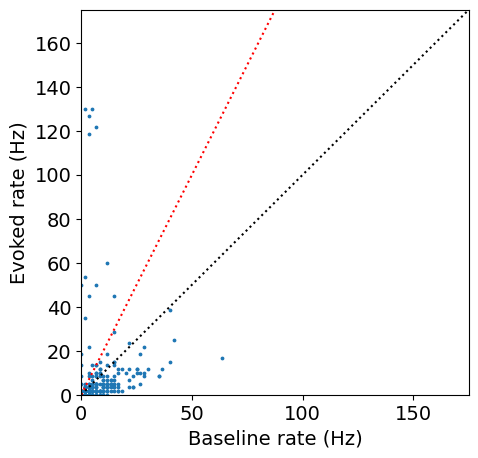

In [ ]:
plt.figure(figsize=(5,5))

plt.scatter(baseline_rate, evoked_rate, s=3)

axis_limit = 175
plt.plot([0,axis_limit],[0,axis_limit], ':k')
plt.plot([0,axis_limit],[0,axis_limit*2], ':r')
plt.xlim([0,axis_limit])
plt.ylim([0,axis_limit])

plt.xlabel('Baseline rate (Hz)')
_ = plt.ylabel('Evoked rate (Hz)')

There are a smaller fraction of light-driven units in this Sst-Cre mouse, but the effect of optogenetic stimulation is still obvious. Let's look at the waveforms for the units that increase their firing rate at least 2x above baseline:

/usr/local/lib/python3.11/dist-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'hdmf-common' version 1.1.3 because version 1.8.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/usr/local/lib/python3.11/dist-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.2.2 because version 2.7.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."


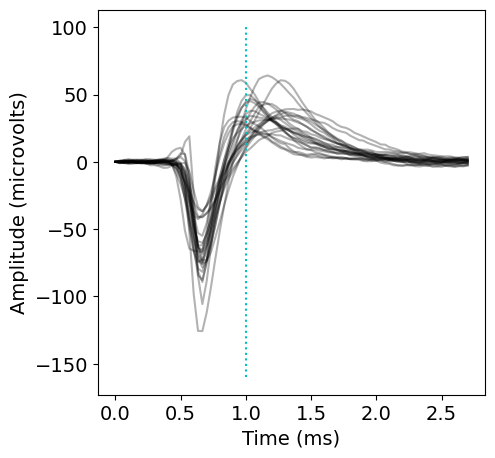

In [ ]:
cre_pos_units = da.unit_id[(evoked_rate / (baseline_rate + 1)) > 2].values

plt.figure(figsize=(5,5))

for unit_id in cre_pos_units:

    peak_channel = session.units.loc[unit_id].peak_channel_id
    wv = session.mean_waveforms[unit_id].sel(channel_id = peak_channel)

    plt.plot(wv.time * 1000, wv, 'k', alpha=0.3)

plt.xlabel('Time (ms)')
plt.ylabel('Amplitude (microvolts)')
_ =plt.plot([1.0, 1.0],[-160, 100],':c')

As expected, we see a mix of fast-spiking and regular-spiking waveforms, in contrast to the primarily fast-spiking waveforms of the Parvalbumin+ units.

Now, let's take a look at light-evoked activity in a VIP-Cre mouse:

In [ ]:
vip_sessions = sessions[sessions.full_genotype.str.match('Vip')]
session = cache.get_session_data(vip_sessions.index.values[-1])

/usr/local/lib/python3.11/dist-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'hdmf-common' version 1.1.3 because version 1.8.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/usr/local/lib/python3.11/dist-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.2.2 because version 2.7.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."


In [ ]:
trials = session.optogenetic_stimulation_epochs[(session.optogenetic_stimulation_epochs.duration > 0.009) & \
                                                (session.optogenetic_stimulation_epochs.duration < 0.02)]

units = session.units[session.units.ecephys_structure_acronym.str.match('VIS')]

bin_edges = np.arange(-0.01, 0.025, 0.0005)

da = optotagging_spike_counts(bin_edges, trials, units)

/usr/local/lib/python3.11/dist-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'hdmf-common' version 1.1.3 because version 1.8.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/usr/local/lib/python3.11/dist-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.2.2 because version 2.7.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/usr/local/lib/python3.11/dist-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'hdmf-common' version 1.1.3 because version 1.8.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/usr/local/lib/python3.11/dist-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.2.2 because version 2.7.0 is already loaded.
  warn("Ignoring cached namespace '%s' vers

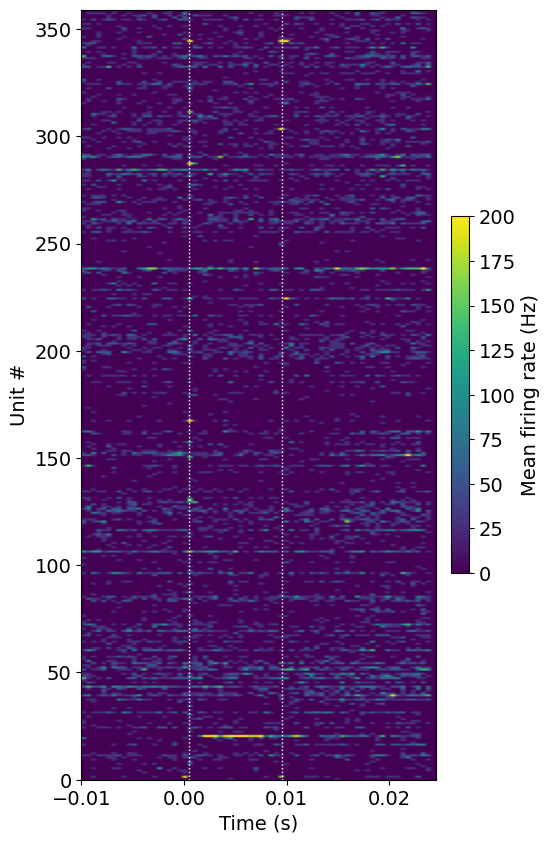

In [ ]:
plot_optotagging_response(da)

This response looks much different than the examples above. There is only one unit (out of more than 350 in cortex) that is obviously responding to the 10 ms light pulse. Even though the yield for VIP-Cre mice is extremely low, these units will be extremely valuable to analyze. If we can characterize the stereotypical firing patterns displayed by labeled VIP+ interneurons, we may be able to identify them in unlabeled recordings.

# Final dir structure

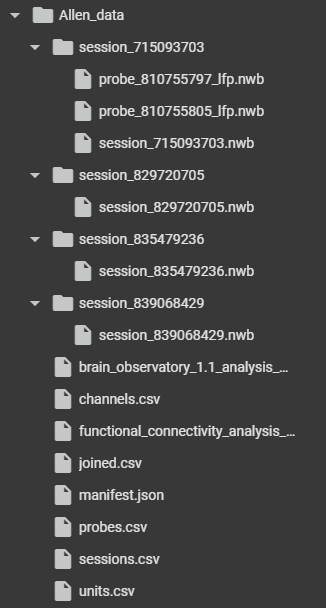

# Thank you!

In [ ]:
import time
from IPython.display import display, HTML

def countdown_timer(minutes, seconds):
    display(HTML(f"""
    <p id="timer" style="font-size:300px; color: red;"></p>
    <script>
    var minutes = {minutes};
    var seconds = {seconds};
    var timer = document.getElementById("timer");
    function updateTimer() {{
        if (seconds == 0 && minutes == 0) {{
            timer.innerHTML = "<span style='font-size: 200px; background-image: url(https://cdn.pixabay.com/animation/2024/02/08/10/06/10-06-13-48_512.gif); background-clip: text; color: transparent; -webkit-background-clip: text;'>Thank you!</span>";
            // timer.innerHTML = "Time's up!";
        }} else {{
            if (seconds == 0) {{
                minutes--;
                seconds = 59;
            }} else {{
                seconds--;
            }}
            var minutesDisplay = minutes.toString().padStart(2, '0');
            var secondsDisplay = seconds.toString().padStart(2, '0');
            timer.innerHTML = minutesDisplay + ":" + secondsDisplay;
            setTimeout(updateTimer, 1000);
        }}
    }}
    updateTimer();
    </script>
    """))

# Run the countdown timer for x minutes and x seconds
countdown_timer(0, 0)

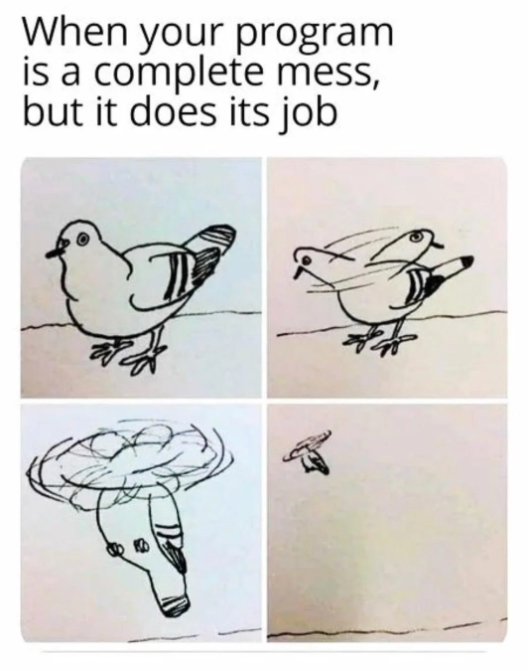